## Data Exploration


In [143]:
#Gideons Portion of Unpacking

import pandas as pd
from collections import defaultdict
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
import nltk
from nltk.tokenize import regexp_tokenize, word_tokenize, RegexpTokenizer
from nltk.corpus import stopwords, wordnet
from nltk import pos_tag
from nltk.stem import WordNetLemmatizer
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import accuracy_score, precision_score, confusion_matrix, plot_confusion_matrix

from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_extraction.text import TfidfVectorizer
import string
import nltk
from nltk.corpus import stopwords
from nltk import word_tokenize




bills=pd.read_csv('data/house_legislation_116.csv')

In [144]:
def get_wordnet_pos(treebank_tag):
    '''
    Translate nltk POS to wordnet tags
    '''
    if treebank_tag.startswith('J'):
        return wordnet.ADJ
    elif treebank_tag.startswith('V'):
        return wordnet.VERB
    elif treebank_tag.startswith('N'):
        return wordnet.NOUN
    elif treebank_tag.startswith('R'):
        return wordnet.ADV
    else:
        return wordnet.NOUN

In [145]:
len(bills)

5806

In [146]:
#to today
#Drop NAs, establish preprocessing pipeline? Eh.  Sure.
#join selected extra elements.
#NLP Bill summary.
#OneHotEncode Subject, Committees,..... cosponsors... related_bills?


##pull in pass fail target.
#by linking bill_id to
#binary? Or multiclass? Passed house verusus is law?
#the simipliest would be just using bill_id and result from house_rollcall_info_116, this would be a pass fail result.  the results column to the bill_id in house_legi too simple? make it more complex later. got it.
#then save new dataframe off.

In [147]:
rollinfo=pd.read_csv('data/house_rollcall_info_116.csv')

rollinfo['result'].value_counts()

P    307
A    187
F    148
Name: result, dtype: int64

In [148]:
bjdf=bills.merge(rollinfo[['bill_id','result']])

In [149]:
bjdf.head()

,bill_id,title,sponsor,cosponsors,related_bills,policy_area,subjects,committees,bill_progress,summary,date_introduced,number,bill_type,result
0,H.R.1,"To expand Americans' access to the ballot box,...",S001168,"['P000197', 'A000370', 'A000376', 'B001300', '...","['H.R.44', 'H.R.93', 'H.R.137', 'H.R.138', 'H....",Government Operations and Politics,['Administrative law and regulatory procedures...,"['House Administration', 'House Intelligence (...",Passed House,"This bill addresses voter access, election int...",2019-01-03,1,H.R.,A
1,H.R.1,"To expand Americans' access to the ballot box,...",S001168,"['P000197', 'A000370', 'A000376', 'B001300', '...","['H.R.44', 'H.R.93', 'H.R.137', 'H.R.138', 'H....",Government Operations and Politics,['Administrative law and regulatory procedures...,"['House Administration', 'House Intelligence (...",Passed House,"This bill addresses voter access, election int...",2019-01-03,1,H.R.,F
2,H.R.1,"To expand Americans' access to the ballot box,...",S001168,"['P000197', 'A000370', 'A000376', 'B001300', '...","['H.R.44', 'H.R.93', 'H.R.137', 'H.R.138', 'H....",Government Operations and Politics,['Administrative law and regulatory procedures...,"['House Administration', 'House Intelligence (...",Passed House,"This bill addresses voter access, election int...",2019-01-03,1,H.R.,F
3,H.R.1,"To expand Americans' access to the ballot box,...",S001168,"['P000197', 'A000370', 'A000376', 'B001300', '...","['H.R.44', 'H.R.93', 'H.R.137', 'H.R.138', 'H....",Government Operations and Politics,['Administrative law and regulatory procedures...,"['House Administration', 'House Intelligence (...",Passed House,"This bill addresses voter access, election int...",2019-01-03,1,H.R.,F
4,H.R.1,"To expand Americans' access to the ballot box,...",S001168,"['P000197', 'A000370', 'A000376', 'B001300', '...","['H.R.44', 'H.R.93', 'H.R.137', 'H.R.138', 'H....",Government Operations and Politics,['Administrative law and regulatory procedures...,"['House Administration', 'House Intelligence (...",Passed House,"This bill addresses voter access, election int...",2019-01-03,1,H.R.,F


In [150]:
len(bjdf)

471

In [151]:
rollinfo['question'].value_counts()

On Agreeing to the Amendment                                               280
On Passage                                                                  62
On Agreeing to the Resolution                                               55
On Motion to Suspend the Rules and Pass                                     55
On Motion to Suspend the Rules and Pass, as Amended                         46
On Motion to Recommit with Instructions                                     46
On Ordering the Previous Question                                           41
On Approving the Journal                                                    13
On Motion to Suspend the Rules and Agree, as Amended                         6
On Motion to Suspend the Rules and Agree                                     5
On Motion to Table                                                           5
On Motion to Adjourn                                                         3
On Motion to Commit with Instructions               

In [152]:
bills['bill_progress'].value_counts()

Introduced                  5314
Passed House                 305
Agreed to in House           124
Became Law                    46
Agreed to in Senate            8
Passed Senate                  5
Failed House                   2
Failed to pass over veto       1
To President                   1
Name: bill_progress, dtype: int64

In [153]:
## two options.  
# I could recatgorize everything to Pass Fail. 
# In short Introdueced being dead in committe (failed)
# Passed House Being killed in the senate
# Agreed to in the house ?????
# Became Law is passed
# Agreed to in Senante is ???
# Failed House is ???
# To Presidnet is failed to pass, a veto.  Since its not paid.
# Faield to pass over Veto sounds like it was actively vetoed and still not passed.  




# I run with all the options.... tricky thing is... well....  The target is Became Law.   If I just left it as predict bill out come.
# some groups have to too few for a train test split for example ..... it would be much easier to just reclassify everything as pass fail...
# Okay then.

In [154]:
bills.isna().sum()

bill_id               0
title                 0
sponsor               0
cosponsors            0
related_bills         0
policy_area         236
subjects              0
committees            0
bill_progress         0
summary            3380
date_introduced      24
number                0
bill_type             0
dtype: int64

In [155]:
# new problem.. over half the bills dont have summaries....

# the titles have complete data...
# its that.  Or I cut half the data.
# or try to fill in the missing data through manual scrapping myself...
#scrapping the same source myself.... is possible.  But in a week possible? I'm not sure...

# i guess scrapping attempt is worth trying.. whats the cut off before I go with summary or give up.  Two days?  End of day tomorrow, if i havent ifugred it out by end of day tomorrow I'll move on with 

### Feature Creation

Features to Create:

-Number of bill cosponsors
-Party alignment of cosponsors
-
-
-

In [156]:
house=pd.read_csv('Data/house_members_116.csv')

myList=[]
auxiliaryList = []


def cleaning(word):
    output=word.replace('[','')
    output=output.replace(']','')
    output=output.replace(',','')
    output=output.replace('"','')
    output=output.strip('\"')
    output=output.strip('\'')
    return output
    

for x in house['committee_assignments']:
    temp=x.split()
    #need to add to a rolling list..
    for j in temp:
        ctemp=cleaning(j)
        myList.append(ctemp)

    #so once I split it, it becomes a list...
  
#oooohhh that isnt actually a list... its a string thats looking like a list...

In [157]:
pd.Series(myList).unique()

#oh no the stripping, it pulling individual words now, not phrases....
# at this point its just easier to hard code it in no?

array(['Agriculture', 'Armed', 'Services', 'Education', 'and', 'Labor',
       'Financial', 'Appropriations', 'House', 'Administration',
       'Foreign', 'Affairs', 'Transportation', 'Infrastructure',
       'Veterans', '', 'Judiciary', 'Oversight', 'Reform', 'Select',
       'Committee', 'on', 'the', 'Climate', 'Crisis', 'Ways', 'Means',
       'Science', 'Space', 'Technology', 'Small', 'Business', 'Energy',
       'Commerce', 'Homeland', 'Security', 'Natural', 'Resources',
       'Budget', 'Modernization', 'of', 'Congress', 'Ethics', 'Rules',
       'Permanent', 'Intelligence', 'Chair', 'Majority', 'Whip',
       'Ranking', 'Member', 'Vice', 'Leader', 'Senior', 'Chief', 'Deputy',
       'Chairperson', 'Assistant', 'Speaker', 'Minority', 'The',
       'Chairman'], dtype=object)

In [158]:
Bills=pd.read_csv('Data/bills_116.csv')

In [159]:
null_data = Bills[Bills.isnull().any(axis=1)]

#Much Better!!!

In [160]:
null_data


#I am assuming that Null bills wont have passed but I dont have a way to confirm that...  Okay.. How about I pull only a list of Bill IDs from the NAs and compare it to the other one... yeah.

#ooor I can just do it the other way around and just pull sure do a drop NA and then check if the ones left are yeah thats worth trying



,web-scraper-order,web-scraper-start-url,paginator,bill_id,link_to_bill-href,bill_name,committees,summary
7,1684270638-8,https://www.congress.gov/search?q={%22source%2...,https://www.congress.gov/search?q=%7B%22source...,H.R.8575,https://www.congress.gov/bill/116th-congress/h...,Preserving Charitable Incentives Act,Committees: House - Ways and Means,NaN
25,1684270741-26,https://www.congress.gov/search?q={%22source%2...,https://www.congress.gov/search?q=%7B%22source...,H.R.8593,https://www.congress.gov/bill/116th-congress/h...,Preserving Charitable Incentives Act,Committees: House - Ways and Means,NaN
26,1684270750-27,https://www.congress.gov/search?q={%22source%2...,https://www.congress.gov/search?q=%7B%22source...,H.R.8594,https://www.congress.gov/bill/116th-congress/h...,Preserving Charitable Incentives Act,Committees: House - Ways and Means,NaN
27,1684270755-28,https://www.congress.gov/search?q={%22source%2...,https://www.congress.gov/search?q=%7B%22source...,H.R.8595,https://www.congress.gov/bill/116th-congress/h...,Preserving Charitable Incentives Act,Committees: House - Ways and Means,NaN
34,1684270790-35,https://www.congress.gov/search?q={%22source%2...,https://www.congress.gov/search?q=%7B%22source...,H.R.8602,https://www.congress.gov/bill/116th-congress/h...,Preserving Charitable Incentives Act,Committees: House - Ways and Means,NaN
...,...,...,...,...,...,...,...,...
2723,1684284385-2724,https://www.congress.gov/search?q={%22source%2...,NaN,H.R.8992,https://www.congress.gov/bill/116th-congress/h...,Blockchain Technology Coordination Act of 2020,Committees: House - Energy and Commerce,"Specifically, the bill provides that the Under..."
2724,1684284388-2725,https://www.congress.gov/search?q={%22source%2...,NaN,H.R.8993,https://www.congress.gov/bill/116th-congress/h...,Blockchain Technology Coordination Act of 2020,Committees: House - Energy and Commerce,This bill requires the Department of Homeland ...
2725,1684284391-2726,https://www.congress.gov/search?q={%22source%2...,NaN,H.R.8994,https://www.congress.gov/bill/116th-congress/h...,Blockchain Technology Coordination Act of 2020,Committees: House - Energy and Commerce,This bill permits individuals who filed a comp...
2726,1684284394-2727,https://www.congress.gov/search?q={%22source%2...,NaN,H.R.8995,https://www.congress.gov/bill/116th-congress/h...,Blockchain Technology Coordination Act of 2020,Committees: House - Energy and Commerce,This bill establishes programs that provide in...


In [161]:
Billsnona=Bills.dropna()

In [162]:
#merge nonas to main.

tomerge=Bills[['summary','bill_id']]


bills.merge(tomerge)

,bill_id,title,sponsor,cosponsors,related_bills,policy_area,subjects,committees,bill_progress,summary,date_introduced,number,bill_type


In [163]:
bills.isna().sum()

bill_id               0
title                 0
sponsor               0
cosponsors            0
related_bills         0
policy_area         236
subjects              0
committees            0
bill_progress         0
summary            3380
date_introduced      24
number                0
bill_type             0
dtype: int64

#### New Problem.  

The problem is.  Well.  The data I scrapped is a different set of bills?? Which is odd...  
The second problem is the summaries... well they're missing.... for half of the policy areas.


I only need about 1,000 rows of data. With removing summaries we've met that goal by double. so.   Maybe I do something else....

Another possibility is... ignoring summaries entirely and just going with a partiasian approach but that seems... foolish.  So I guess we're dropping the extra NAs... all of them... the 50% of the data.  Thats going to be, well its already day 3 and I haven't been able to meet the requirements....

The bills that do pass there is only 47 (there is no way a bill passed without having a summary written for it, meaning those without I think died.  Need to confirm that)
Assuming that is the case then of the remaining classes there should still be sufficent data to train a model on...

A general model?  There are almost as many bills that passed as there are committees (by about half)  But still.   47 bills passing is... not very much.   Given say 4 bills per committee that pass?



Due to a lack of classes I may not be able to train a less general model.....  I may have to just... treat the classifcation as a matter of... 

# Questions to Answer

- Which Commitee Introduces the Most Bills to the Floor
- Which Commitee has the most bills passed into Law
- How many bills did each Committee Have assinged to it.  
- Does Partisain Balance Matter On different committees? I dont think either party has a lack of a desire to pass laws on any issue is just what kind of laws they want to pass.

In [164]:
butchered=bills.dropna()#['bill_progress'].value_counts()

In [165]:
bills['bill_progress'].value_counts()

Introduced                  5314
Passed House                 305
Agreed to in House           124
Became Law                    46
Agreed to in Senate            8
Passed Senate                  5
Failed House                   2
Failed to pass over veto       1
To President                   1
Name: bill_progress, dtype: int64

#### New Prolem Evaluation

We are losing alot of laws... nearly 10?? and 70....

Well... I can still try to use the summary...

Each law dies if it is not passed in the time of the 2 year session of hte congress meaning anything that is not "Became Law" by the end of the session died which makes that simplier.   

I have to take the... shorter overview instead.... some of the titles are.... I wonder how many are the same.


In [166]:
bills['title'].equals(bills['summary'])


for i in range(len(bills)):
    temp=bills.loc[i, "title"]==(bills.loc[i, "summary"])
    if temp == True:
        print(temp)

# conclusion, None are the same.
# Two things to consider, this does not view the bill itself merely the summary written... second this is just a predictive model for a grad not a tool to solve a real problem in this case and only in this case I can just drop I guess.

# Exploring NLP

Two Options.  Ngrams, and Count Vectorizers

In [167]:
nltk.download('stopwords')
sw = stopwords.words('english') + list(string.punctuation)



tf_vec = TfidfVectorizer(token_pattern=r"([a-zA-Z]+(?:'[a-z]+)?)", stop_words=sw)



X = butchered['summary']
y = butchered['bill_progress']


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.5, random_state=57)



[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/Gideon/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [168]:
corpus=[]


for x in X_train:
    manual_cleanup=x.split()
    corpus.append(manual_cleanup)



In [169]:

def remove_punctuation(from_text):
    table = str.maketrans('', '', string.punctuation)
    stripped = [w.translate(table) for w in from_text]
    return stripped



rain_pos_no_punctuation = [remove_punctuation(i) for i in corpus]

In [170]:
rain_pos_no_punctuation

[['This',
  'bill',
  'directs',
  'the',
  'Federal',
  'Communications',
  'Commission',
  'to',
  'make',
  'grants',
  'for',
  'the',
  'establishment',
  'or',
  'expansion',
  'of',
  'job',
  'training',
  'programs',
  'for',
  'communications',
  'tower',
  'service',
  'construction',
  'maintenance',
  'and',
  'structural',
  'modification',
  'This',
  'bill',
  'directs',
  'the',
  'Federal',
  'Communications',
  'Commission',
  'to',
  'make',
  'grants',
  'for',
  'the',
  'establishment',
  'or',
  'expansion',
  'of',
  'job',
  'training',
  'programs',
  'for',
  'communications',
  'tower',
  'service',
  'construction',
  'maintenance',
  'and',
  'structural',
  'modification'],
 ['This',
  'bill',
  'exempts',
  'certain',
  'water',
  'transfers',
  'between',
  'public',
  'water',
  'supplies',
  'in',
  'Texas',
  'Arkansas',
  'and',
  'Louisiana',
  'from',
  'prohibitions',
  'on',
  'illegal',
  'trade',
  'of',
  'plants',
  'and',
  'wildlife',
  '

In [171]:
sw = stopwords.words('english')

In [172]:

#needs to be applied to each element of hte list....
final=[]

for entry in rain_pos_no_punctuation:
    manual_cleanup = [token.translate(str.maketrans('', '', '0123456789')) for token in entry]
    final.append(manual_cleanup)

In [173]:
final

[['This',
  'bill',
  'directs',
  'the',
  'Federal',
  'Communications',
  'Commission',
  'to',
  'make',
  'grants',
  'for',
  'the',
  'establishment',
  'or',
  'expansion',
  'of',
  'job',
  'training',
  'programs',
  'for',
  'communications',
  'tower',
  'service',
  'construction',
  'maintenance',
  'and',
  'structural',
  'modification',
  'This',
  'bill',
  'directs',
  'the',
  'Federal',
  'Communications',
  'Commission',
  'to',
  'make',
  'grants',
  'for',
  'the',
  'establishment',
  'or',
  'expansion',
  'of',
  'job',
  'training',
  'programs',
  'for',
  'communications',
  'tower',
  'service',
  'construction',
  'maintenance',
  'and',
  'structural',
  'modification'],
 ['This',
  'bill',
  'exempts',
  'certain',
  'water',
  'transfers',
  'between',
  'public',
  'water',
  'supplies',
  'in',
  'Texas',
  'Arkansas',
  'and',
  'Louisiana',
  'from',
  'prohibitions',
  'on',
  'illegal',
  'trade',
  'of',
  'plants',
  'and',
  'wildlife',
  '

# SO

so the thing we need.  

In [174]:
test_list = [4, 5, 4, 6, 7, 5, 4, 5, 4, 6, 4, 6, 9, 8]
 
# printing original list
print("The original list is : " + str(test_list))
 
# initializing ranges
range_list = [(2, 4), (7, 8), (10, 12)]
 
res = []
for ele in range_list:
     
    # extending ranges
    res.extend(test_list[ele[0] : ele[1] + 1])
 
# printing result
print("Ranges elements : " + str(res))

The original list is : [4, 5, 4, 6, 7, 5, 4, 5, 4, 6, 4, 6, 9, 8]
Ranges elements : [4, 6, 7, 5, 4, 4, 6, 9]


In [175]:
# house_members_116

# so this has to extract, the committee members of each

#how would this work.  I want a master list of committees each with a list of members on it.... something that takes each , hmm... a dictionary i think
# each key being a committee with its values being the members there of.... as well as the members' party affilation..
#how to make that...


# basically all I want for each committe assignment is the ratio of democrates to republicans.  oh... could I do that in


#going to need a list of unique committes



committe_list=['Agriculture','Appropriations','Armed Services','Budget','Education and Labor', 'Energy and Commerce','Ethics', 'Financial Services','Foreign Affairs', 'Intelligence', 'Judiciary', 'Rules', 'Science, Space, and Technology', 'Select Committee on the Climate Crisis','Small Business','Transportation and Infrastructure',"Veterans' Affairs",'Ways and Means', 'Homeland Security','House Administration','Natural Resources','Oversight and Reform',"Veterans' Affairs"]


#not very pyhtonic i know could probaly try exploding??

committe_list=pd.DataFrame(committe_list, columns=['Committees'])
committe_list['Republican']=''
committe_list['Democrate']=''

Democratic=0
Republican=0
i=0

for x in committe_list['Committees']:
    i=i+1    
    for index, row in house.iterrows():
        if x in row['committee_assignments']:
            if row['current_party']=='Republican':
                Republican=Republican+1
                print(x," Repbulican ",Republican)
            elif row['current_party']=='Democratic':
                Democratic=Democratic+1
                print(x, " Democrate ",Democratic)
        ###save it off to the committee running total and then reset it to 0...
        ### then we have to get the partiasin total back into a running total for that committee.... that keeps getting updated..
    committe_list.at[x,'Republican']=Republican
    committe_list.at[x,'Democrate']=Democratic
    Democratic=0
    Republican=0

    #could it also just look at a commmittee_assignment and if x in committee_assignments:



Agriculture  Repbulican  1
Agriculture  Democrate  1
Agriculture  Repbulican  2
Agriculture  Democrate  2
Agriculture  Repbulican  3
Agriculture  Repbulican  4
Agriculture  Repbulican  5
Agriculture  Democrate  3
Agriculture  Democrate  4
Agriculture  Democrate  5
Agriculture  Repbulican  6
Agriculture  Repbulican  7
Agriculture  Democrate  6
Agriculture  Democrate  7
Agriculture  Democrate  8
Agriculture  Repbulican  8
Agriculture  Repbulican  9
Agriculture  Democrate  9
Agriculture  Repbulican  10
Agriculture  Repbulican  11
Agriculture  Democrate  10
Agriculture  Repbulican  12
Agriculture  Democrate  11
Agriculture  Repbulican  13
Agriculture  Democrate  12
Agriculture  Repbulican  14
Agriculture  Repbulican  15
Agriculture  Democrate  13
Agriculture  Repbulican  16
Agriculture  Democrate  14
Agriculture  Democrate  15
Agriculture  Repbulican  17
Agriculture  Democrate  16
Agriculture  Democrate  17
Agriculture  Democrate  18
Agriculture  Democrate  19
Agriculture  Democrate  20
Ag

In [176]:
committe_list

,Committees,Republican,Democrate
0,Agriculture,,
1,Appropriations,,
2,Armed Services,,
3,Budget,,
4,Education and Labor,,
5,Energy and Commerce,,
6,Ethics,,
7,Financial Services,,
8,Foreign Affairs,,
9,Intelligence,,


In [177]:
## so now I need to get the ifnromation above first as a ratio  and then as a rolling ration for each bill.... I guess the model might take that into account automatically? seeing which is attached..

## the thinking is.   A cumulativfe multipler.. of the partiasain ratio of each committee multiped together.  For each bill.  The multipler serving as teh factor... so... if the bill is going to 4 committees
## the ratio of each committe is multipled together to form a culmualtive ratio total for that bill likelihood.. (can uh,.. can they. do that?? can they change where it goes??)


# so something like...

# could just do what Jeeves did.... well here's the other thing all the precocessing steps... can just be blackbix? no that eoesnt work they have to be able to replicate what I dod to know I wasnt cheating iwth the results.
committe_list.to_csv('Committee_Assignments.csv')



### Manual Cleaning Here 

(honestly just faster for now)

In [178]:
cleaned_CL=pd.read_csv('Data/Committee_Assignments_Cleaned.csv')

In [179]:
cleaned_CL=cleaned_CL[['Committees','Republican','Democrate']]

cleaned_CL['Ratio']=(cleaned_CL.Democrate/(cleaned_CL.Republican+cleaned_CL.Democrate))
#this isnt working because there are strings. not lists..... they look lists but they're strings... making them lists just makes them... acutally lists with the smae [''] inside of the list.. thats why I was trying
# to remove the text manually.  However.  I still needed to remove the in
# so exploding it wouldnt "matter" or rahter wouldn't work here because 
cleaned_CL

#so my only option is to... manually remove the [] '' but still split on commas.... acutally on a ,_ a comma followed by a space as the combinations ', '   
# some seem to not have '' around both entries and thata's okay...
# some seem to have only one entry and thats okay just need an if to handle htat exception.  something like.  if 'entry' does not contain a comma ... treat it as a single entry, remove ''s and []s and then save the reaming text as an entry

#the whole hope and point of this is to create a list of eveyr committee assignment in this specific session of congress to ensure the list I was using to manually create / hard code a list was accurate annnnd to be alittle more pythonic..
#I can see being told that this is both too pythonic and not pythonic enough... sooo making a custom stripping function...

,Committees,Republican,Democrate,Ratio
0,Agriculture,21,26,0.553191
1,Appropriations,23,30,0.566038
2,Armed Services,26,31,0.543860
3,Budget,13,22,0.628571
4,Education and Labor,22,28,0.560000
5,Energy and Commerce,24,31,0.563636
6,Ethics,5,5,0.500000
7,Financial Services,26,34,0.566667
8,Foreign Affairs,21,26,0.553191
9,Intelligence,9,13,0.590909


In [180]:
holding=[]


house['committee_assignments']


def cleaning(word):
    output=word.replace('[','')
    output=output.replace(']','')
    output=output.replace('"','')
    output=output.replace("'",'')
    return output
    

for x in house['committee_assignments']:
    holding.append(cleaning(x))

In [181]:
holding

['Agriculture, Armed Services',
 'Agriculture, Education and Labor, Financial Services',
 'Appropriations',
 'Appropriations, House Administration',
 'Agriculture, Education and Labor',
 'Foreign Affairs, Transportation and Infrastructure, Veterans Affairs',
 '',
 'Appropriations',
 'Judiciary, Oversight and Reform, Select Committee on the Climate Crisis',
 'Ways and Means',
 'Agriculture, Financial Services',
 'Science, Space, and Technology, Transportation and Infrastructure',
 'Agriculture, Armed Services',
 'Agriculture, Science, Space, and Technology',
 'Science, Space, and Technology, Small Business, Transportation and Infrastructure',
 'Armed Services, Education and Labor, Veterans Affairs',
 'Financial Services, Veterans Affairs',
 'Energy and Commerce, Homeland Security',
 'Foreign Affairs, Judiciary',
 'Financial Services',
 'Foreign Affairs, Science, Space, and Technology',
 'Armed Services, Veterans Affairs',
 'Science, Space, and Technology, Ways and Means',
 'Judiciary, S

In [182]:
fixed=[]

for j in holding:
    fixed=j.split(', ')

    #might need an if statment here... something to split into two outcomes.
    #oh dear.. .also Science, And TEchnology... those are commas too... so this l....

    ## all of this to try and prove I wasn't they happening noramlly in the first place...

    #we'll just assume.. uh... that I got it right? and move on I guess...

In [183]:
fixed

['Financial Services', 'Foreign Affairs']

In [184]:
### Feature Creation.   

#Party Alignment of Committe:


# Average Party Aligment.
# Party alignment abitrarilly defined as  "Number of Democrates/Number of Republicans"

# Defining Variables
temp=0.0
cumulative=0.0
# Define a seperate list of committee ratios.  A dictionary I guess?  Where each key is a committee and each value is a ratio of the Number of Democrateas to republicans on that commitee Guess I gotta make that now...



for row in df:
    for committee in row['committees']:
        temp= ratios['committee'] #numer of Democrates/Number of Republicans
        if cumulative =0.0:
            culmulative=temp
        else:
            culmulative=temp*cumulative
        row['D/R_Cumulative_Committe_Ratio']=culmulative

SyntaxError: invalid syntax (<ipython-input-184-07eeed67da19>, line 19)

# Count Vectorizer


In [185]:
butchered

,bill_id,title,sponsor,cosponsors,related_bills,policy_area,subjects,committees,bill_progress,summary,date_introduced,number,bill_type
0,H.R.1,"To expand Americans' access to the ballot box,...",S001168,"['P000197', 'A000370', 'A000376', 'B001300', '...","['H.R.44', 'H.R.93', 'H.R.137', 'H.R.138', 'H....",Government Operations and Politics,['Administrative law and regulatory procedures...,"['House Administration', 'House Intelligence (...",Passed House,"This bill addresses voter access, election int...",2019-01-03,1,H.R.
1,H.R.3,"To establish a fair price negotiation program,...",P000034,"['N000015', 'S000185', 'L000557', 'K000382', '...","['H.R.4619', 'H.R.4649', 'H8607', 'H.R.4663']",Health,[],"['House Energy and Commerce', 'House Ways and ...",Introduced,This bill establishes several programs and req...,2019-09-19,3,H.R.
3,H.R.5,To prohibit discrimination on the basis of sex...,C001084,"['F000466', 'C001119', 'D000629', 'H001087', '...","['H.Res.377', 'S.788']","Civil Rights and Liberties, Minority Issues","['Civil actions and liability', 'Consumer cred...","['House Judiciary', 'House Education and Labor...",Passed House,This bill prohibits discrimination based on se...,2019-03-13,5,H.R.
4,H.R.6,To authorize the cancellation of removal and a...,R000486,"['V000081', 'C001067', 'A000371', 'B001300', '...","['H.R.2820', 'H.R.2821', 'H.Res.415', 'S.874']",Immigration,['Administrative law and regulatory procedures...,"['House Judiciary', 'House Education and Labor']",Passed House,This bill cancels and prohibits removal procee...,2019-03-12,6,H.R.
5,H.R.7,To amend the Fair Labor Standards Act of 1938 ...,D000216,"['P000197', 'H000874', 'C000537', 'S000185', '...","['H.Res.252', 'S.270']",Labor and Employment,['Administrative law and regulatory procedures...,['House Education and Labor'],Passed House,This bill addresses wage discrimination on the...,2019-01-30,7,H.R.
...,...,...,...,...,...,...,...,...,...,...,...,...,...
5791,H.Con.Res.57,Authorizing the use of Emancipation Hall for a...,B001270,[],['H.Con.Res.53'],Congress,"['Commemorative events and holidays', 'Racial ...",['House Administration'],Agreed to in Senate,This concurrent resolution authorizes the use ...,2019-08-09,57,H.Con.Res.
5793,H.Con.Res.59,Recognizing the significance of equal pay and ...,A000370,"['L000581', 'F000462', 'S001175', 'E000299', '...",['H.Con.Res.30'],Labor and Employment,['Employment discrimination and employee right...,['House Education and Labor'],Introduced,This concurrent resolution recognizes the disp...,2019-08-23,59,H.Con.Res.
5798,H.Con.Res.64,Recognizing the 25th anniversary of AmeriCorps.,M001163,"['P000523', 'N000147', 'M000087', 'S001185', '...","['S.Res.326', 'S5669-5670', 'S5666']",Labor and Employment,[],['House Education and Labor'],Introduced,This concurrent resolution recognizes the sign...,2019-09-18,64,H.Con.Res.
5799,H.Con.Res.65,Supporting the clean vehicle emissions standar...,D000623,"['L000579', 'H001068', 'B001300', 'L000551', '...",['S.Res.316'],Environmental Protection,['Administrative law and regulatory procedures...,['House Energy and Commerce'],Introduced,This concurrent resolution supports existing r...,2019-09-19,65,H.Con.Res.


In [186]:
vec = CountVectorizer(token_pattern=r"([a-zA-Z]+(?:'[a-z]+)?)", stop_words=sw)
X = vec.fit_transform(butchered['summary'][0:])

df = pd.DataFrame(X.toarray(), columns=vec.get_feature_names())
df

,abandoned,abandoning,abatement,abducted,abducting,abduction,abide,ability,abingdon,abkhazia,...,yucca,yuma,zero,zetas,zip,zone,zones,zoning,zoonotic,zte
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2391,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2392,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2393,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2394,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


#### Evaluation

Where there is a counter vectorizer... but clearly some of those should be represented by the same word like abandon and abaonding same with abducted and abduction
 hmm so lets get lemmmmtiziingg B)

In [187]:
nltk.download('tagsets')
nltk.help.upenn_tagset()
nltk.download('averaged_perceptron_tagger')
lemmatizer= nltk.stem.WordNetLemmatizer()


def prep(doc):
    pattern = "([a-zA-Z]+(?:'[a-z]+)?)"
    tokenizer = RegexpTokenizer(pattern)
    #^I dont really want it to do this each time thats relalllly computaitonally in efficent... so it could take in those other arugments i suppose...
    sample_doc = tokenizer.tokenize(doc)
    # for the docuemnt which is just a string.
    sample_doc = [token.lower() for token in sample_doc]
    sample_doc = [token for token in sample_doc if token not in sw]
    #maybe not lemmetizing here?
    sample_doc = [lemmatizer.lemmatize(token) for token in sample_doc]
    sample_doc_tagged = pos_tag(sample_doc)
    sample_doc_tagged = [(pair[0], get_wordnet_pos(pair[1])) for pair in sample_doc_tagged]
    return sample_doc_tagged

#so this would be feed into another loop a for loop.   

#Do I want to do a word net? I guess I should...

$: dollar
    $ -$ --$ A$ C$ HK$ M$ NZ$ S$ U.S.$ US$
'': closing quotation mark
    ' ''
(: opening parenthesis
    ( [ {
): closing parenthesis
    ) ] }
,: comma
    ,
--: dash
    --
.: sentence terminator
    . ! ?
:: colon or ellipsis
    : ; ...
CC: conjunction, coordinating
    & 'n and both but either et for less minus neither nor or plus so
    therefore times v. versus vs. whether yet
CD: numeral, cardinal
    mid-1890 nine-thirty forty-two one-tenth ten million 0.5 one forty-
    seven 1987 twenty '79 zero two 78-degrees eighty-four IX '60s .025
    fifteen 271,124 dozen quintillion DM2,000 ...
DT: determiner
    all an another any both del each either every half la many much nary
    neither no some such that the them these this those
EX: existential there
    there
FW: foreign word
    gemeinschaft hund ich jeux habeas Haementeria Herr K'ang-si vous
    lutihaw alai je jour objets salutaris fille quibusdam pas trop Monte
    terram fiche oui corporis ...
IN: preposition or

[nltk_data] Downloading package tagsets to /Users/Gideon/nltk_data...
[nltk_data]   Package tagsets is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /Users/Gideon/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


In [188]:
test= 'this is a test documenat of alot of words. mice that I am trying to have fed into a prep funciton.  I will not copy a job description I am interested in.  Zipline is an equal opportunity employer and prohibits discrimination and harassment of any type without regard to race, color, ancestry, national origin, religion or religious creed, mental or physical disability, medical condition, genetic information, sex (including pregnancy, childbirth, and related medical conditions), sexual orientation, gender identity, gender expression, age, marital status, military or veteran status, citizenship, or other characteristics protected by state, federal or local law or our other policies.'

In [189]:
test2=prep(test)
type(test2)
test2
#is that okay can I feed a list... into a tokenizer?? Or how does that work in NLP??

[('test', 'n'),
 ('documenat', 'n'),
 ('alot', 'n'),
 ('word', 'n'),
 ('mouse', 'n'),
 ('trying', 'v'),
 ('fed', 'v'),
 ('prep', 'a'),
 ('funciton', 'n'),
 ('copy', 'n'),
 ('job', 'n'),
 ('description', 'n'),
 ('interested', 'a'),
 ('zipline', 'n'),
 ('equal', 'a'),
 ('opportunity', 'n'),
 ('employer', 'n'),
 ('prohibits', 'v'),
 ('discrimination', 'n'),
 ('harassment', 'n'),
 ('type', 'n'),
 ('without', 'n'),
 ('regard', 'n'),
 ('race', 'n'),
 ('color', 'n'),
 ('ancestry', 'v'),
 ('national', 'a'),
 ('origin', 'n'),
 ('religion', 'n'),
 ('religious', 'a'),
 ('creed', 'n'),
 ('mental', 'a'),
 ('physical', 'a'),
 ('disability', 'n'),
 ('medical', 'a'),
 ('condition', 'n'),
 ('genetic', 'a'),
 ('information', 'n'),
 ('sex', 'n'),
 ('including', 'v'),
 ('pregnancy', 'n'),
 ('childbirth', 'n'),
 ('related', 'v'),
 ('medical', 'a'),
 ('condition', 'n'),
 ('sexual', 'a'),
 ('orientation', 'n'),
 ('gender', 'n'),
 ('identity', 'n'),
 ('gender', 'n'),
 ('expression', 'n'),
 ('age', 'n'),
 ('ma

In [190]:



for doc in butchered['summary']:
    print(prep(doc))
## Ideally I save this back into the dataframe again...

[('bill', 'n'), ('address', 'n'), ('voter', 'a'), ('access', 'n'), ('election', 'n'), ('integrity', 'n'), ('election', 'n'), ('security', 'n'), ('political', 'a'), ('spending', 'n'), ('ethic', 'a'), ('three', 'n'), ('branch', 'a'), ('government', 'n'), ('specifically', 'r'), ('bill', 'n'), ('expands', 'v'), ('voter', 'a'), ('registration', 'n'), ('voting', 'v'), ('access', 'n'), ('make', 'v'), ('election', 'n'), ('day', 'n'), ('federal', 'a'), ('holiday', 'n'), ('limit', 'n'), ('removing', 'v'), ('voter', 'n'), ('voter', 'n'), ('roll', 'n'), ('bill', 'n'), ('provides', 'v'), ('state', 'n'), ('establish', 'v'), ('independent', 'a'), ('nonpartisan', 'a'), ('redistricting', 'v'), ('commission', 'n'), ('bill', 'n'), ('also', 'r'), ('set', 'v'), ('forth', 'a'), ('provision', 'n'), ('related', 'v'), ('election', 'n'), ('security', 'n'), ('including', 'v'), ('sharing', 'v'), ('intelligence', 'n'), ('information', 'n'), ('state', 'n'), ('election', 'n'), ('official', 'n'), ('protecting', 'v'),

In [191]:

butchered['processed']=None

butchered['Processed_Bills'] = butchered['summary'].apply(lambda row: prep(row))


# apply or map to the dataframe..   .apply() or .map()  newcolumn= coulmn.appply(function)


<ipython-input-191-c3d437b48924>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  butchered['processed']=None
<ipython-input-191-c3d437b48924>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  butchered['Processed_Bills'] = butchered['summary'].apply(lambda row: prep(row))


In [192]:
butchered

,bill_id,title,sponsor,cosponsors,related_bills,policy_area,subjects,committees,bill_progress,summary,date_introduced,number,bill_type,processed,Processed_Bills
0,H.R.1,"To expand Americans' access to the ballot box,...",S001168,"['P000197', 'A000370', 'A000376', 'B001300', '...","['H.R.44', 'H.R.93', 'H.R.137', 'H.R.138', 'H....",Government Operations and Politics,['Administrative law and regulatory procedures...,"['House Administration', 'House Intelligence (...",Passed House,"This bill addresses voter access, election int...",2019-01-03,1,H.R.,None,"[(bill, n), (address, n), (voter, a), (access,..."
1,H.R.3,"To establish a fair price negotiation program,...",P000034,"['N000015', 'S000185', 'L000557', 'K000382', '...","['H.R.4619', 'H.R.4649', 'H8607', 'H.R.4663']",Health,[],"['House Energy and Commerce', 'House Ways and ...",Introduced,This bill establishes several programs and req...,2019-09-19,3,H.R.,None,"[(bill, n), (establishes, v), (several, a), (p..."
3,H.R.5,To prohibit discrimination on the basis of sex...,C001084,"['F000466', 'C001119', 'D000629', 'H001087', '...","['H.Res.377', 'S.788']","Civil Rights and Liberties, Minority Issues","['Civil actions and liability', 'Consumer cred...","['House Judiciary', 'House Education and Labor...",Passed House,This bill prohibits discrimination based on se...,2019-03-13,5,H.R.,None,"[(bill, n), (prohibits, v), (discrimination, n..."
4,H.R.6,To authorize the cancellation of removal and a...,R000486,"['V000081', 'C001067', 'A000371', 'B001300', '...","['H.R.2820', 'H.R.2821', 'H.Res.415', 'S.874']",Immigration,['Administrative law and regulatory procedures...,"['House Judiciary', 'House Education and Labor']",Passed House,This bill cancels and prohibits removal procee...,2019-03-12,6,H.R.,None,"[(bill, n), (cancel, v), (prohibits, n), (remo..."
5,H.R.7,To amend the Fair Labor Standards Act of 1938 ...,D000216,"['P000197', 'H000874', 'C000537', 'S000185', '...","['H.Res.252', 'S.270']",Labor and Employment,['Administrative law and regulatory procedures...,['House Education and Labor'],Passed House,This bill addresses wage discrimination on the...,2019-01-30,7,H.R.,None,"[(bill, n), (address, n), (wage, n), (discrimi..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5791,H.Con.Res.57,Authorizing the use of Emancipation Hall for a...,B001270,[],['H.Con.Res.53'],Congress,"['Commemorative events and holidays', 'Racial ...",['House Administration'],Agreed to in Senate,This concurrent resolution authorizes the use ...,2019-08-09,57,H.Con.Res.,None,"[(concurrent, a), (resolution, n), (authorizes..."
5793,H.Con.Res.59,Recognizing the significance of equal pay and ...,A000370,"['L000581', 'F000462', 'S001175', 'E000299', '...",['H.Con.Res.30'],Labor and Employment,['Employment discrimination and employee right...,['House Education and Labor'],Introduced,This concurrent resolution recognizes the disp...,2019-08-23,59,H.Con.Res.,None,"[(concurrent, a), (resolution, n), (recognizes..."
5798,H.Con.Res.64,Recognizing the 25th anniversary of AmeriCorps.,M001163,"['P000523', 'N000147', 'M000087', 'S001185', '...","['S.Res.326', 'S5669-5670', 'S5666']",Labor and Employment,[],['House Education and Labor'],Introduced,This concurrent resolution recognizes the sign...,2019-09-18,64,H.Con.Res.,None,"[(concurrent, a), (resolution, n), (recognizes..."
5799,H.Con.Res.65,Supporting the clean vehicle emissions standar...,D000623,"['L000579', 'H001068', 'B001300', 'L000551', '...",['S.Res.316'],Environmental Protection,['Administrative law and regulatory procedures...,['House Energy and Commerce'],Introduced,This concurrent resolution supports existing r...,2019-09-19,65,H.Con.Res.,None,"[(concurrent, n), (resolution, n), (support, n..."


In [193]:
butchered['policy_area'].value_counts()

Taxation                                       349
Health                                         188
Crime and Law Enforcement                      166
Government Operations and Politics             153
International Affairs                          150
Public Lands and Natural Resources             136
Congress                                       136
Transportation and Public Works                119
Finance and Financial Sector                   111
Armed Forces and National Security             101
Immigration                                     88
Economics and Public Finance                    69
Labor and Employment                            64
Energy                                          62
Science, Technology, Communications             60
Commerce                                        50
Civil Rights and Liberties, Minority Issues     48
Education                                       46
Environmental Protection                        41
Emergency Management           

In [194]:
# could this be something like.....
# df['newcolumn']=

#no...
##  for i in len(df['column']):


## well before I manually referenced to columns....


# Next Steps:


Next Steps.....  

Simple Model.


Base Model... would assume??? what? 

And then Simple Model Classifiing for all targets.

Could map targets

In [195]:
X=butchered.summary
y=butchered.bill_progress


X_train, X_test, y_train, y_test = train_test_split(X,
                                                    y,
                                                    random_state=578,
                                                    test_size=0.25)

In [196]:
lemmatizer = WordNetLemmatizer()

In [197]:
text_data = X_train.apply(lambda x: prep(x))

In [198]:
token_docs = [prep(doc) for doc in X_train]

In [199]:
X_t, X_val, y_t, y_val = train_test_split(token_docs, y_train,
                                          test_size=0.25, random_state=42)

In [200]:
X_t

[[('bill', 'n'),
  ('prohibits', 'v'),
  ('awarding', 'v'),
  ('contract', 'n'),
  ('entity', 'n'),
  ('procurement', 'n'),
  ('rolling', 'v'),
  ('stock', 'n'),
  ('use', 'n'),
  ('public', 'a'),
  ('transportation', 'n'),
  ('manufacturer', 'n'),
  ('rolling', 'v'),
  ('stock', 'n'),
  ('incorporated', 'v'),
  ('manufacturing', 'n'),
  ('facility', 'n'),
  ('united', 'v'),
  ('state', 'n'),
  ('owned', 'v'),
  ('controlled', 'v'),
  ('entity', 'n'),
  ('based', 'v'),
  ('country', 'n'),
  ('identified', 'v'),
  ('nonmarket', 'a'),
  ('economy', 'n'),
  ('country', 'n'),
  ('identified', 'v'),
  ('office', 'n'),
  ('u', 'a'),
  ('trade', 'n'),
  ('representative', 'n'),
  ('ustr', 'a'),
  ('priority', 'n'),
  ('foreign', 'a'),
  ('country', 'n'),
  ('e', 'v'),
  ('g', 'a'),
  ('country', 'n'),
  ('protect', 'v'),
  ('intellectual', 'a'),
  ('property', 'n'),
  ('right', 'n'),
  ('subject', 'a'),
  ('monitoring', 'n'),
  ('ustr', 'n'),
  ('includes', 'v'),
  ("people's", 'a'),
  ('repu

### Dummy Model

ValueError: The number of FixedLocator locations (7), usually from a call to set_ticks, does not match the number of ticklabels (8).

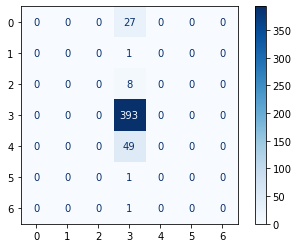

In [359]:





from sklearn.dummy import DummyClassifier
from sklearn.metrics import plot_confusion_matrix
clf_dummy = DummyClassifier(random_state=42, strategy='most_frequent') 
#establishing random_state for reproducibility
clf_dummy.fit(X_train, y_train)
y_pred = clf_dummy.predict(X_test)
plot_confusion_matrix(estimator=clf_dummy, X=X_test, y_true=y_test,cmap='Blues')









/Users/Gideon/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning: Pass labels=['Passed House' 'Introduced' 'Passed Senate' 'Became Law' 'To President'
 'Agreed to in House' 'Failed House' 'Failed to pass over veto'
 'Agreed to in Senate'] as keyword args. From version 0.25 passing these as positional arguments will result in an error
  warnings.warn("Pass {} as keyword args. From version 0.25 "
<ipython-input-60-ec6965428e16>:15: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels([''] + labels)
<ipython-input-60-ec6965428e16>:16: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels([''] + labels)


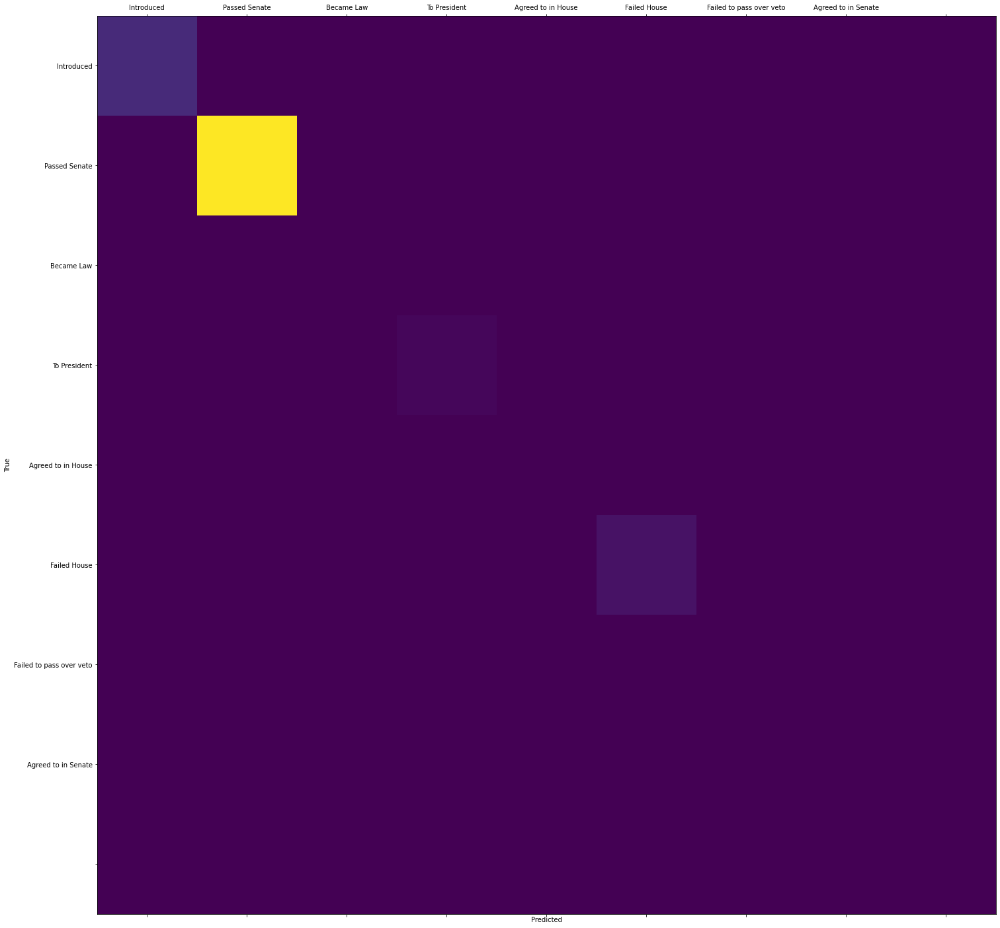

In [ ]:
from sklearn.metrics import plot_confusion_matrix
import matplotlib.pyplot as plt




labels=butchered.bill_progress.unique()

cm = confusion_matrix(y_train, y_train, labels)
fig = plt.figure(figsize=(25,25))

ax = fig.add_subplot(111)
cax = ax.matshow(cm)

ax.set_xticklabels([''] + labels)
ax.set_yticklabels([''] + labels)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()


## this isnt looking right and I dont know why, it seems to be using an out dated package but also is wrong in some other ways.


In [ ]:
butchered['bill_progress'].value_counts()

Introduced                  2022
Passed House                 224
Agreed to in House           100
Became Law                    35
Agreed to in Senate            7
Passed Senate                  4
Failed House                   2
Failed to pass over veto       1
To President                   1
Name: bill_progress, dtype: int64

# Dummy Model


Were we to just do a dummy model and we guessed only the most common outcome (that of being the bill died and never progressed to _any_ stage then we would be right 80% of the time.  This... means in order for our model to offer any value it needs to be .... better than that, signficantly.  Say 90% or more.)

# Trying a Count Vectorizer

In [ ]:
def doc_preparer(doc, stop_words=sw):
    '''
    
    :param doc: a document from the satire corpus 
    :return: a document string with words which have been 
            lemmatized, 
            parsed for stopwords, 
            made lowercase,
            and stripped of punctuation and numbers.
    '''
    
    regex_token = RegexpTokenizer(r"([a-zA-Z]+(?:’[a-z]+)?)")
    lower = doc.lower()
    tokens = regex_token.tokenize(lower)
    no_sw = [token for token in tokens if token not in stop_words]
    tagged = pos_tag(no_sw)
    wordnet_tag = [(word[0], get_wordnet_pos(word[1])) for word in tagged]
    lemmatizer = WordNetLemmatizer()
    lemmas = [lemmatizer.lemmatize(word[0], word[1]) for word in wordnet_tag]
    # Highlight why we would join or not
    return ' '.join(lemmas)

In [ ]:
X2=butchered.summary
y2=butchered.bill_progress


X_train2, X_test2, y_train2, y_test2 = train_test_split(X2,
                                                        y2,
                                                        random_state=348,
                                                        test_size=0.25)

In [ ]:
text_data = X_train2.apply(lambda x: doc_preparer(x))
text_data

3655    bill direct department education award grant s...
2546    bill require department treasury define dollar...
3103    bill direct national oceanic atmospheric admin...
1057    bill prohibit department health human service ...
2730    bill prohibit expense abortion take account pu...
                              ...                        
168     bill direct department transportation dot carr...
2770    bill increase hour service require employee cl...
693     bill authorize transportation security adminis...
534     bill direct department treasury issue billion ...
838     bill require agency receives fee fine penalty ...
Name: summary, Length: 1797, dtype: object

In [ ]:
token_docs = [doc_preparer(doc, sw) for doc in X_train2]
token_docs

['bill direct department education award grant state library administrative agency enable award subgrants eligible local educational agency summer early reading program hold school summer lunch site bill direct department education award grant state library administrative agency enable award subgrants eligible local educational agency summer early reading program hold school summer lunch site',
 'bill require department treasury define dollar term fix weight gold base day close market price gold federal reserve bank shall make federal reserve note exchangeable gold statutory gold definition dollar bill require department treasury define dollar term fix weight gold base day close market price gold federal reserve bank shall make federal reserve note exchangeable gold statutory gold definition dollar',
 'bill direct national oceanic atmospheric administration award grant state local government indian tribe nonprofit organization implement climate resilient live shoreline project encourag

In [ ]:
X_t2, X_val2, y_t2, y_val2 = train_test_split(token_docs, y_train2,
                                          test_size=0.25, random_state=42)

In [202]:
cv = CountVectorizer(max_features=5)

X_t_vec = cv.fit_transform(X_t2)
X_t_vec = pd.DataFrame.sparse.from_spmatrix(X_t_vec)
X_t_vec.columns = sorted(cv.vocabulary_)
X_t_vec.set_index(y_t2.index, inplace=True)

In [203]:
X_t_vec


,bill,department,program,provide,state
2698,2,0,0,4,0
3188,2,0,0,0,0
856,2,0,0,0,0
5780,0,0,0,0,0
2911,6,0,0,0,0
...,...,...,...,...,...
5088,0,0,0,0,0
2983,2,2,0,0,0
3839,2,0,0,0,0
884,4,0,0,0,0


In [204]:
X_val_vec = cv.transform(X_val2)
X_val_vec  = pd.DataFrame.sparse.from_spmatrix(X_val_vec)
X_val_vec.columns = sorted(cv.vocabulary_)
X_val_vec.set_index(y_val2.index, inplace=True)
X_val_vec

,bill,department,program,provide,state
368,2,4,0,0,0
2305,2,2,2,2,0
2079,4,2,8,2,0
5214,0,0,0,0,0
5736,0,0,0,0,2
...,...,...,...,...,...
5312,0,0,0,0,0
1081,2,2,0,0,0
376,2,0,0,0,0
3017,2,0,4,2,0


In [205]:
mnb = MultinomialNB()

mnb.fit(X_t_vec, y_t2)

MultinomialNB()

In [206]:
mnb.class_log_prior_

array([-3.14519217, -5.81934082, -4.31526342, -7.20563518, -7.20563518,
       -0.16860756, -2.37732144, -6.512488  ])

In [207]:
y_t2.value_counts(normalize=True)

# the trouble is... I dont know what these categories mean to... be able to know to reclassify them.  I dont know if 
# If I wanted this to go right.. well.  Im thinking 

Introduced                  0.844840
Passed House                0.092799
Agreed to in House          0.043059
Became Law                  0.013363
Agreed to in Senate         0.002970
Passed Senate               0.001485
Failed to pass over veto    0.000742
Failed House                0.000742
Name: bill_progress, dtype: float64

In [208]:
y_hat = mnb.predict(X_val_vec)
accuracy_score(y_val2, y_hat)

0.7977777777777778

In [209]:
mnb.score(X_val_vec, y_val2)

0.7977777777777778

In [210]:
butchered.keys()

Index(['bill_id', 'title', 'sponsor', 'cosponsors', 'related_bills',
       'policy_area', 'subjects', 'committees', 'bill_progress', 'summary',
       'date_introduced', 'number', 'bill_type', 'processed',
       'Processed_Bills'],
      dtype='object')

/Users/Gideon/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/sklearn/utils/validation.py:67: FutureWarning: Pass labels=['Passed House' 'Introduced' 'Passed Senate' 'Became Law' 'To President'
 'Agreed to in House' 'Failed House' 'Failed to pass over veto'
 'Agreed to in Senate'] as keyword args. From version 0.25 passing these as positional arguments will result in an error
  warnings.warn("Pass {} as keyword args. From version 0.25 "


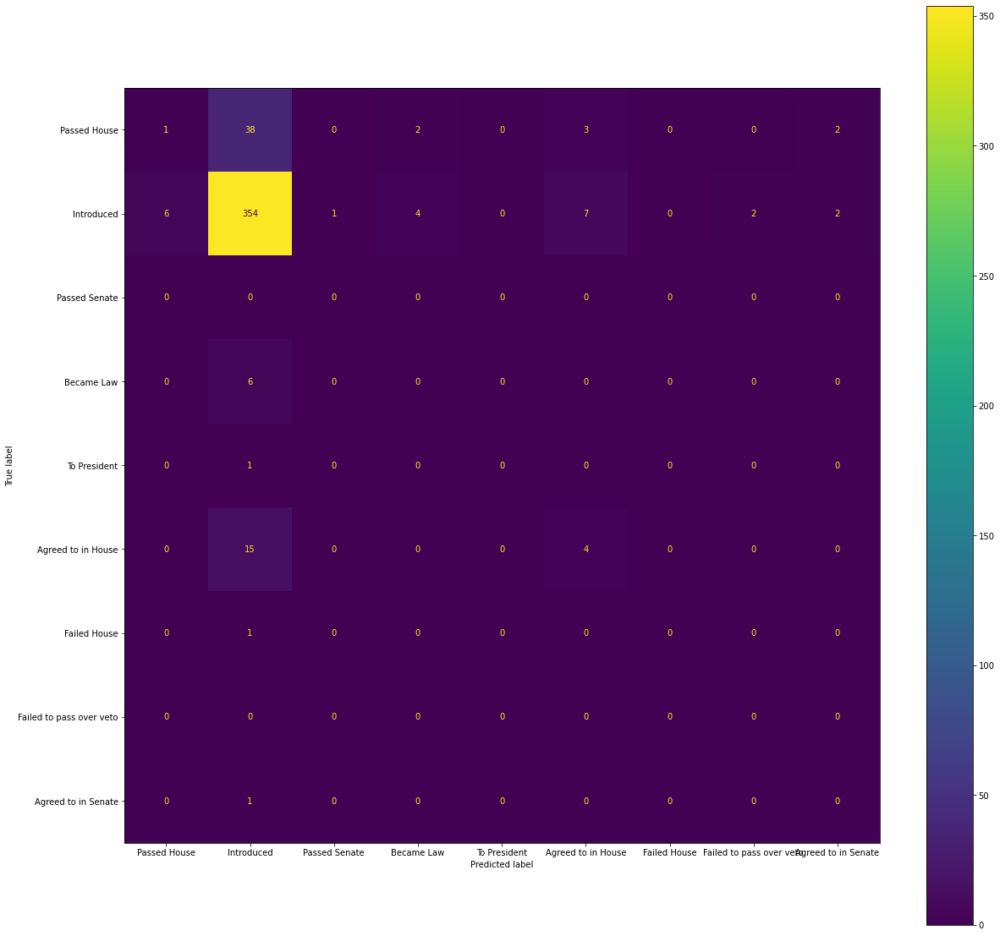

In [211]:
labels=butchered.bill_progress.unique()


fig,ax=plt.subplots(figsize=(20,20))

plot_confusion_matrix(mnb, X_val_vec, y_val2, labels,ax=ax)

## Evaluating

So As the confusion Matrix shows we are doing it wrong... heh.  happily predicting most things as being introduced (or in the other words the majority class), and seems to be missclassifiying a few bills as agreed to when they are just introduced.  It seems to be confusing Agreeed to and introduced if anything it has those to inverted??  Seeming to have that almost backwards.  Predicting when it shouldnt be.  

Oh this was amulti nomial naive bayes.... maybe A Decsiion tree would be better.

In [212]:
## for data
import json
import pandas as pd
import numpy as np
## for plotting
import matplotlib.pyplot as plt
import seaborn as sns
## for processing
import re
import nltk
## for bag-of-words
from sklearn import feature_extraction, model_selection, naive_bayes, pipeline, manifold, preprocessing
## for explainer
from lime import lime_text
## for word embedding



In [213]:

vectorizer = feature_extraction.text.TfidfVectorizer(max_features=1000, ngram_range=(1,5))

In [214]:
butchered.dropna(subset=['summary'], inplace=True)


<ipython-input-214-e4247353afa8>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  butchered.dropna(subset=['summary'], inplace=True)


In [215]:
len(butchered)

2396

### Code Taken From 

https://towardsdatascience.com/text-classification-with-nlp-tf-idf-vs-word2vec-vs-bert-41ff868d1794

In [216]:
butchered.dropna(subset=['summary'], inplace=True)
len(butchered)

<ipython-input-216-4a05dee4acb7>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  butchered.dropna(subset=['summary'], inplace=True)


2396

### Taken from Kaggle

https://www.kaggle.com/code/ayu1391994/nlp-using-random-forest

# Following From THe Following Blogs

https://towardsdatascience.com/hyperparameter-tuning-the-random-forest-in-python-using-scikit-learn-28d2aa77dd74

In [218]:
butchered.isna().sum()

bill_id               0
title                 0
sponsor               0
cosponsors            0
related_bills         0
policy_area           0
subjects              0
committees            0
bill_progress         0
summary               0
date_introduced       0
number                0
bill_type             0
processed          2396
Processed_Bills       0
dtype: int64

In [219]:



holding=[]


#house['committee_assignments']
#for x in house['committee_assignments']:
#    holding.append(cleaning(x))

def cleaning(word):
    output=word.replace('[','')
    output=output.replace(']','')
    output=output.replace('"','')
    output=output.replace("'",'')
    output=output.split(', ')
    return output
    


butchered['cosponsors']=butchered['cosponsors'].apply(cleaning)
butchered['CoSponsor_Count']=[len(set(x)) for x in butchered['cosponsors']]

<ipython-input-219-2b0868cdc292>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  butchered['cosponsors']=butchered['cosponsors'].apply(cleaning)
<ipython-input-219-2b0868cdc292>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  butchered['CoSponsor_Count']=[len(set(x)) for x in butchered['cosponsors']]


In [358]:
testing='this is a test, string, to, see, if, a, list, will, occur, from, this string'

cleaning(testing)

['this is a test',
 'string',
 'to',
 'see',
 'if',
 'a',
 'list',
 'will',
 'occur',
 'from',
 'this string']

In [220]:

butchered.dropna(subset=['summary'], inplace=True)



repub=[]
repub=house[house['current_party']=='Republican']
repub['name_id'].unique()

repub=repub['name_id'].values.tolist()
#doesnt need to be unique huh.. lol

demo=house[house['current_party']=='Democratic']
demo['name_id']

demo=demo['name_id'].values.tolist()



def counting(cospons):
    r=0
    d=0
    ratio=0
    for x in cospons:
        if (x in repub):
            r=r+1
        elif (x in demo):
            d=d+1

    if d==0 or r==0:
        print('No Cosponsors')
        ratio=0
        r=0
        d=0
    else:
        ratio=d/r
        r=0
        d=0
    return ratio

butchered['cosponsor_ratio']=butchered['cosponsors'].map(counting)



<ipython-input-220-d45948a63bc9>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  butchered.dropna(subset=['summary'], inplace=True)


No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cosponsors
No Cos

<ipython-input-220-d45948a63bc9>:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  butchered['cosponsor_ratio']=butchered['cosponsors'].map(counting)


In [221]:
butchered

,bill_id,title,sponsor,cosponsors,related_bills,policy_area,subjects,committees,bill_progress,summary,date_introduced,number,bill_type,processed,Processed_Bills,CoSponsor_Count,cosponsor_ratio
0,H.R.1,"To expand Americans' access to the ballot box,...",S001168,"[P000197, A000370, A000376, B001300, B001281, ...","['H.R.44', 'H.R.93', 'H.R.137', 'H.R.138', 'H....",Government Operations and Politics,['Administrative law and regulatory procedures...,"['House Administration', 'House Intelligence (...",Passed House,"This bill addresses voter access, election int...",2019-01-03,1,H.R.,None,"[(bill, n), (address, n), (voter, a), (access,...",236,0.000000
1,H.R.3,"To establish a fair price negotiation program,...",P000034,"[N000015, S000185, L000557, K000382, D000197, ...","['H.R.4619', 'H.R.4649', 'H8607', 'H.R.4663']",Health,[],"['House Energy and Commerce', 'House Ways and ...",Introduced,This bill establishes several programs and req...,2019-09-19,3,H.R.,None,"[(bill, n), (establishes, v), (several, a), (p...",85,0.000000
3,H.R.5,To prohibit discrimination on the basis of sex...,C001084,"[F000466, C001119, D000629, H001087, M001185, ...","['H.Res.377', 'S.788']","Civil Rights and Liberties, Minority Issues","['Civil actions and liability', 'Consumer cred...","['House Judiciary', 'House Education and Labor...",Passed House,This bill prohibits discrimination based on se...,2019-03-13,5,H.R.,None,"[(bill, n), (prohibits, v), (discrimination, n...",240,79.000000
4,H.R.6,To authorize the cancellation of removal and a...,R000486,"[V000081, C001067, A000371, B001300, C001112, ...","['H.R.2820', 'H.R.2821', 'H.Res.415', 'S.874']",Immigration,['Administrative law and regulatory procedures...,"['House Judiciary', 'House Education and Labor']",Passed House,This bill cancels and prohibits removal procee...,2019-03-12,6,H.R.,None,"[(bill, n), (cancel, v), (prohibits, n), (remo...",232,0.000000
5,H.R.7,To amend the Fair Labor Standards Act of 1938 ...,D000216,"[P000197, H000874, C000537, S000185, D000627, ...","['H.Res.252', 'S.270']",Labor and Employment,['Administrative law and regulatory procedures...,['House Education and Labor'],Passed House,This bill addresses wage discrimination on the...,2019-01-30,7,H.R.,None,"[(bill, n), (address, n), (wage, n), (discrimi...",239,238.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5791,H.Con.Res.57,Authorizing the use of Emancipation Hall for a...,B001270,[],['H.Con.Res.53'],Congress,"['Commemorative events and holidays', 'Racial ...",['House Administration'],Agreed to in Senate,This concurrent resolution authorizes the use ...,2019-08-09,57,H.Con.Res.,None,"[(concurrent, a), (resolution, n), (authorizes...",1,0.000000
5793,H.Con.Res.59,Recognizing the significance of equal pay and ...,A000370,"[L000581, F000462, S001175, E000299, H001080, ...",['H.Con.Res.30'],Labor and Employment,['Employment discrimination and employee right...,['House Education and Labor'],Introduced,This concurrent resolution recognizes the disp...,2019-08-23,59,H.Con.Res.,None,"[(concurrent, a), (resolution, n), (recognizes...",71,0.000000
5798,H.Con.Res.64,Recognizing the 25th anniversary of AmeriCorps.,M001163,"[P000523, N000147, M000087, S001185, S001145, ...","['S.Res.326', 'S5669-5670', 'S5666']",Labor and Employment,[],['House Education and Labor'],Introduced,This concurrent resolution recognizes the sign...,2019-09-18,64,H.Con.Res.,None,"[(concurrent, a), (resolution, n), (recognizes...",13,12.000000
5799,H.Con.Res.65,Supporting the clean vehicle emissions standar...,D000623,"[L000579, H001068, B001300, L000551, B000574, ...",['S.Res.316'],Environmental Protection,['Administrative law and regulatory procedures...,['House Energy and Commerce'],Introduced,This concurrent resolution supports existing r...,2019-09-19,65,H.Con.Res.,None,"[(concurrent, n), (resolution, n), (support, n...",91,0.000000


In [244]:
import re
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer

from sklearn.feature_extraction.text import TfidfVectorizer


corpus = []

from collections import defaultdict

dataset=butchered

dataset.dropna(subset=['summary'], inplace=True)

dataset['summary'].isna().sum()


#prepping the text. (cleaning)
#dataset.processed=dataset['summary'].map(doc_preparer)






# Creating the bag of Word Model




[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/Gideon/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
<ipython-input-244-e9d97bcc633d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataset.dropna(subset=['summary'], inplace=True)
/Users/Gideon/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/pandas/core/generic.py:5168: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


In [ ]:
pd.DataFrame(data, columns=vectorizer.vocabulary_, index=)

In [241]:
print(dataset.TFDIF[0])

  (0, 7686)	0.05525823044709676
  (0, 8678)	0.029728352161684058
  (0, 9559)	0.03557678472008888
  (0, 8)	0.04157927589354451
  (0, 8474)	0.042968767296491274
  (0, 9290)	0.05897703760690178
  (0, 6873)	0.06959021694476966
  (0, 9452)	0.05835037658941171
  (0, 3307)	0.03911509858415572
  (0, 4896)	0.04551629169008201
  (0, 2236)	0.05776171904779472
  (0, 715)	0.04147198335777314
  (0, 842)	0.060366529009848555
  (0, 4191)	0.05897703760690178
  (0, 7398)	0.045197906586559505
  (0, 3352)	0.04008249195482639
  (0, 3407)	0.04852785748868687
  (0, 6976)	0.06198860340550665
  (0, 1512)	0.049213545287895025
  (0, 8032)	0.0561836804450294
  (0, 4493)	0.07024487729714333
  (0, 5656)	0.038949113761238545
  (0, 6990)	0.03358610322669292
  (0, 5096)	0.067874106709694
  (0, 5074)	0.06637732277097587
  :	:
  (2395, 5056)	0.1451506896015592
  (2395, 3554)	0.1722749946607586
  (2395, 6760)	0.2086886810679838
  (2395, 2245)	0.1580508571616065
  (2395, 4125)	0.16444688690877
  (2395, 7248)	0.15479597749

In [290]:

#X=vectorizer.fit_transform((butchered['summary']))
X=dataset[['cosponsor_ratio', 'CoSponsor_Count','summary']]
y=dataset.bill_progress

# Splitting the dataset into the Training set and Test set
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state = 0)


from sklearn.feature_extraction.text import TfidfVectorizer
vectorizer = TfidfVectorizer(preprocessor=doc_preparer, ngram_range = (1,5))


data=vectorizer.fit_transform((X_train['summary']))



datadf=pd.DataFrame.sparse.from_spmatrix(data, columns=sorted(vectorizer.vocabulary_),index=X_train.index)

x_train_final=pd.concat([X_train, datadf], axis=1)


# Only Transform X_test



In [291]:
x_train_final

,cosponsor_ratio,CoSponsor_Count,summary,abandon,abandon august,abandon august state,abandon august state approve,abandon august state approve reclamation,abandon copper,abandon copper mine,...,zone term cascadia subduction,zone term cascadia subduction zone,zte,zte corporation,zte corporation entity,zte corporation entity reasonably,zte corporation entity reasonably believe,zte corporation high,zte corporation high impact,zte corporation high impact moderate
4258,3.571429,32,This bill directs the President to prohibit th...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2480,0.000000,1,This bill requires the government to pay 75% o...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5321,0.000000,3,This resolution (1) supports the designation o...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5055,0.000000,2,This resolution expresses the sense of the Hou...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2078,2.500000,7,"This bill requires the North Country, Ice Age,...",0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1696,0.000000,17,This bill adjusts the boundary of the Santa Mo...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3710,0.200000,6,This bill authorizes the Department of Homelan...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1116,2.250000,39,This bill authorizes advance appropriations fo...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1239,1.166667,13,This bill allows tax-exempt financing of certa...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [292]:
x_train_final=x_train_final.drop('summary',axis=1)

In [354]:

#########RandomForestClassifier         #try Gini?
# Fitting classifier to the Training set
from sklearn.ensemble import RandomForestClassifier
classifier=RandomForestClassifier(n_estimators =1000,criterion="entropy",random_state =0)
classifier.fit(x_train_final,y_train)
# Predicting the Test set results




datatrain=vectorizer.transform((X_test['summary']))



datadf2=pd.DataFrame.sparse.from_spmatrix(datatrain, columns=sorted(vectorizer.vocabulary_),index=X_test.index)

X_test_final=pd.concat([X_test, datadf2], axis=1)


X_test_final=X_test_final.drop('summary',axis=1)

y_pred = classifier.predict(X_test_final)

# Making the Confusion Matrix
from sklearn.metrics import confusion_matrix
cm2 = confusion_matrix(y_test, y_pred)
cm2

/Users/Gideon/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/sklearn/utils/validation.py:508: UserWarning: pandas.DataFrame with sparse columns found.It will be converted to a dense numpy array.
  warnings.warn(
/Users/Gideon/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/sklearn/utils/validation.py:508: UserWarning: pandas.DataFrame with sparse columns found.It will be converted to a dense numpy array.
  warnings.warn(


array([[ 14,   0,   0,  13,   0,   0,   0],
       [  0,   0,   0,   1,   0,   0,   0],
       [  0,   0,   0,   8,   0,   0,   0],
       [  0,   0,   0, 393,   0,   0,   0],
       [  0,   0,   1,  46,   2,   0,   0],
       [  0,   0,   0,   1,   0,   0,   0],
       [  0,   0,   0,   1,   0,   0,   0]])

In [355]:
from sklearn.metrics import f1_score

f1_score(y_test,y_pred, average='weighted')



0.7982173149538669

In [356]:
accuracy_score(y_test, y_pred)

0.8520833333333333

In [312]:
butchered['bill_progress'].value_counts()

Introduced                  2022
Passed House                 224
Agreed to in House           100
Became Law                    35
Agreed to in Senate            7
Passed Senate                  4
Failed House                   2
Failed to pass over veto       1
To President                   1
Name: bill_progress, dtype: int64

In [313]:
len(butchered['bill_progress'])

2396

In [255]:

#butchered[['']]

# first off thats a count vectorizer... I want a IF-IDF...
# Second I want this to be pulling in other features as its X
# Third I need to decide what my Metric will be before fitting.  I think F1 because its the most robust.  Accuracry isnt an option here because there's a sevre class imbalance.
# Meaning.  Percion and recall....

## this is just pullin the corpus... I want it to pull some other things as well.... things like. the numberic things.... so... can I feed it to it without it being an array..... hm.. I'm not sure..
## But I need to.


In [295]:
from sklearn.model_selection import RandomizedSearchCV
# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 200, stop = 2000, num = 10)]
# Number of features to consider at every split
max_features = ['auto', 'sqrt']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 110, num = 11)]
max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
# Create the random grid
random_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'bootstrap': bootstrap}
print(random_grid)
{'bootstrap': [True, False],
 'max_depth': [10, 20, 30, 40, 50, 60, 70, 80, 90, 100, None],
 'max_features': ['auto', 'sqrt'],
 'min_samples_leaf': [1, 2, 4],
 'min_samples_split': [2, 5, 10],
 'n_estimators': [200, 400, 600, 800, 1000, 1200, 1400, 1600, 1800, 2000]}

{'n_estimators': [200, 400, 600, 800, 1000, 1200, 1400, 1600, 1800, 2000], 'max_features': ['auto', 'sqrt'], 'max_depth': [10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 110, None], 'min_samples_split': [2, 5, 10], 'min_samples_leaf': [1, 2, 4], 'bootstrap': [True, False]}


{'bootstrap': [True, False],
 'max_depth': [10, 20, 30, 40, 50, 60, 70, 80, 90, 100, None],
 'max_features': ['auto', 'sqrt'],
 'min_samples_leaf': [1, 2, 4],
 'min_samples_split': [2, 5, 10],
 'n_estimators': [200, 400, 600, 800, 1000, 1200, 1400, 1600, 1800, 2000]}

In [296]:
# Use the random grid to search for best hyperparameters
# First create the base model to tune

# Random search of parameters, using 3 fold cross validation, 
# search across 100 different combinations, and use all available cores
rf_random = RandomizedSearchCV(estimator = classifier, param_distributions = random_grid, n_iter = 100, cv = 3, verbose=2, random_state=42, n_jobs = -1, refit=True)
# Fit the random search model
rf_random.fit(x_train_final, y_train)

Fitting 3 folds for each of 100 candidates, totalling 300 fits


/Users/Gideon/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/sklearn/model_selection/_split.py:670: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=3.
  warnings.warn(("The least populated class in y has only %d"
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
/Users/Gideon/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/joblib/externals/loky/process_executor.py:688: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed: 19.2min
[Parallel(n_jobs=-1)]: Done 138 tasks      | elapsed: 299.7min
[Parallel(n_jobs=-1)]: Done 300 out of 300 | elapsed: 636.5min finished
/Users/Gideon/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/sklearn/utils/validation.py:508: UserWarning: pandas.DataFrame with sparse columns found.It will be converted

RandomizedSearchCV(cv=3,
                   estimator=RandomForestClassifier(criterion='entropy',
                                                    n_estimators=1000,
                                                    random_state=0),
                   n_iter=100, n_jobs=-1,
                   param_distributions={'bootstrap': [True, False],
                                        'max_depth': [10, 20, 30, 40, 50, 60,
                                                      70, 80, 90, 100, 110,
                                                      None],
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_leaf': [1, 2, 4],
                                        'min_samples_split': [2, 5, 10],
                                        'n_estimators': [200, 400, 600, 800,
                                                         1000, 1200, 1400, 1600,
                                                         1800

In [297]:
best=rf_random.best_params_

In [318]:
rf_random.best_estimator_

RandomForestClassifier(bootstrap=False, criterion='entropy', max_depth=50,
                       max_features='sqrt', min_samples_leaf=2,
                       n_estimators=800, random_state=0)

In [315]:
import pickle 

pickle.dump(best, open('RFmodelmk1.pkl','wb'))

In [298]:
pred_1=rf_random.predict(X_test_final)

/Users/Gideon/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/sklearn/utils/validation.py:508: UserWarning: pandas.DataFrame with sparse columns found.It will be converted to a dense numpy array.
  warnings.warn(


In [311]:
f1_score(y_test,pred_1, average='weighted')


#give those parameters...

0.782694761005717

In [310]:
accuracy_score(y_test, y_pred)

0.8520833333333333

In [309]:
training=classifier.predict(x_train_final)


accuracy_score(y_train, training)

/Users/Gideon/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/sklearn/utils/validation.py:508: UserWarning: pandas.DataFrame with sparse columns found.It will be converted to a dense numpy array.
  warnings.warn(


1.0

In [308]:
f1_score(y_train, training, average='weighted')

1.0

In [274]:
butchered['bill_type'].unique()

#'bill_progress'

array(['H.R.', 'H.Res.', 'H.J.Res.', 'H.Con.Res.'], dtype=object)

In [281]:
butchered['bill_progress'].value_counts()

Introduced                  2022
Passed House                 224
Agreed to in House           100
Became Law                    35
Agreed to in Senate            7
Passed Senate                  4
Failed House                   2
Failed to pass over veto       1
To President                   1
Name: bill_progress, dtype: int64

### Next Steps

Well the next stpes arre
- Trying variations of the random forest parameters...
- Creating a feature of number of sponsors for a bill.
- Creating a feautre of partiasian split of sponsors for a bill.
- Number of Related Bills?? Nah
- Intorduce those into a model
- Try a Bert Model?

In [137]:
# First Things First Create the New Data.
# 
butchered.head() 

,bill_id,title,sponsor,cosponsors,related_bills,policy_area,subjects,committees,bill_progress,summary,date_introduced,number,bill_type,processed,Processed_Bills
0,H.R.1,"To expand Americans' access to the ballot box,...",S001168,"['P000197', 'A000370', 'A000376', 'B001300', '...","['H.R.44', 'H.R.93', 'H.R.137', 'H.R.138', 'H....",Government Operations and Politics,['Administrative law and regulatory procedures...,"['House Administration', 'House Intelligence (...",Passed House,"This bill addresses voter access, election int...",2019-01-03,1,H.R.,None,"[(bill, n), (address, n), (voter, a), (access,..."
1,H.R.3,"To establish a fair price negotiation program,...",P000034,"['N000015', 'S000185', 'L000557', 'K000382', '...","['H.R.4619', 'H.R.4649', 'H8607', 'H.R.4663']",Health,[],"['House Energy and Commerce', 'House Ways and ...",Introduced,This bill establishes several programs and req...,2019-09-19,3,H.R.,None,"[(bill, n), (establishes, v), (several, a), (p..."
3,H.R.5,To prohibit discrimination on the basis of sex...,C001084,"['F000466', 'C001119', 'D000629', 'H001087', '...","['H.Res.377', 'S.788']","Civil Rights and Liberties, Minority Issues","['Civil actions and liability', 'Consumer cred...","['House Judiciary', 'House Education and Labor...",Passed House,This bill prohibits discrimination based on se...,2019-03-13,5,H.R.,None,"[(bill, n), (prohibits, v), (discrimination, n..."
4,H.R.6,To authorize the cancellation of removal and a...,R000486,"['V000081', 'C001067', 'A000371', 'B001300', '...","['H.R.2820', 'H.R.2821', 'H.Res.415', 'S.874']",Immigration,['Administrative law and regulatory procedures...,"['House Judiciary', 'House Education and Labor']",Passed House,This bill cancels and prohibits removal procee...,2019-03-12,6,H.R.,None,"[(bill, n), (cancel, v), (prohibits, n), (remo..."
5,H.R.7,To amend the Fair Labor Standards Act of 1938 ...,D000216,"['P000197', 'H000874', 'C000537', 'S000185', '...","['H.Res.252', 'S.270']",Labor and Employment,['Administrative law and regulatory procedures...,['House Education and Labor'],Passed House,This bill addresses wage discrimination on the...,2019-01-30,7,H.R.,None,"[(bill, n), (address, n), (wage, n), (discrimi..."


In [139]:
type(butchered['cosponsors'][0])

## Greet.... goot strip the list back to a string... might as well make an unstrinning function...

str

In [88]:
teststring=butchered['cosponsors'][0]

In [102]:



holding=[]


#house['committee_assignments']
#for x in house['committee_assignments']:
#    holding.append(cleaning(x))

def cleaning(word):
    print(word)
    print(type(word))
    output=word.replace('[','')
    output=output.replace(']','')
    output=output.replace('"','')
    output=output.replace("'",'')
    output=output.split(', ')
    return output
    

cleaned=cleaning(teststring)


['P000197', 'A000370', 'A000376', 'B001300', 'B001281', 'B001292', 'B000490', 'B000574', 'B001278', 'B001296', 'B001304', 'B001285', 'B001286', 'B001251', 'C001112', 'C001097', 'C001090', 'C001055', 'C001117', 'C001066', 'C001080', 'C001084', 'C001123', 'C001101', 'C001067', 'C001049', 'C000537', 'C001068', 'C001078', 'C000754', 'C001110', 'C001069', 'C001124', 'C001119', 'C001111', 'C001121', 'C000984', 'D000629', 'D000096', 'D000598', 'D000631', 'D000191', 'D000197', 'D000216', 'D000617', 'D000630', 'D000627', 'D000623', 'D000610', 'D000624', 'D000482', 'E000179', 'E000299', 'E000215', 'E000297', 'E000296', 'F000468', 'F000462', 'G000571', 'G000574', 'G000559', 'G000587', 'G000586', 'G000592', 'G000585', 'G000553', 'G000551', 'H001080', 'H001090', 'H000324', 'H001081', 'H001064', 'H001038', 'H001087', 'H001047', 'H001066', 'H001085', 'H000874', 'H001068', 'J000032', 'J000298', 'J000294', 'J000288', 'K000009', 'K000375', 'K000385', 'K000379', 'K000389', 'K000380', 'K000381', 'K000394'

In [103]:
type(cleaned)

list

In [104]:
len(set(cleaned))

236

In [106]:
butchered

,bill_id,title,sponsor,cosponsors,related_bills,policy_area,subjects,committees,bill_progress,summary,date_introduced,number,bill_type,processed,Processed_Bills,13
0,H.R.1,"To expand Americans' access to the ballot box,...",S001168,"['P000197', 'A000370', 'A000376', 'B001300', '...","['H.R.44', 'H.R.93', 'H.R.137', 'H.R.138', 'H....",Government Operations and Politics,['Administrative law and regulatory procedures...,"['House Administration', 'House Intelligence (...",Passed House,"This bill addresses voter access, election int...",2019-01-03,1.0,H.R.,None,"[(bill, n), (address, n), (voter, a), (access,...",NaN
1,H.R.3,"To establish a fair price negotiation program,...",P000034,"['N000015', 'S000185', 'L000557', 'K000382', '...","['H.R.4619', 'H.R.4649', 'H8607', 'H.R.4663']",Health,[],"['House Energy and Commerce', 'House Ways and ...",Introduced,This bill establishes several programs and req...,2019-09-19,3.0,H.R.,None,"[(bill, n), (establishes, v), (several, a), (p...",bill address voter access elect integr elect s...
3,H.R.5,To prohibit discrimination on the basis of sex...,C001084,"['F000466', 'C001119', 'D000629', 'H001087', '...","['H.Res.377', 'S.788']","Civil Rights and Liberties, Minority Issues","['Civil actions and liability', 'Consumer cred...","['House Judiciary', 'House Education and Labor...",Passed House,This bill prohibits discrimination based on se...,2019-03-13,5.0,H.R.,None,"[(bill, n), (prohibits, v), (discrimination, n...",bill prohibit discrimin base sex sexual orient...
4,H.R.6,To authorize the cancellation of removal and a...,R000486,"['V000081', 'C001067', 'A000371', 'B001300', '...","['H.R.2820', 'H.R.2821', 'H.Res.415', 'S.874']",Immigration,['Administrative law and regulatory procedures...,"['House Judiciary', 'House Education and Labor']",Passed House,This bill cancels and prohibits removal procee...,2019-03-12,6.0,H.R.,None,"[(bill, n), (cancel, v), (prohibits, n), (remo...",bill cancel prohibit remov proceed certain ali...
5,H.R.7,To amend the Fair Labor Standards Act of 1938 ...,D000216,"['P000197', 'H000874', 'C000537', 'S000185', '...","['H.Res.252', 'S.270']",Labor and Employment,['Administrative law and regulatory procedures...,['House Education and Labor'],Passed House,This bill addresses wage discrimination on the...,2019-01-30,7.0,H.R.,None,"[(bill, n), (address, n), (wage, n), (discrimi...",bill address wage discrimin basi sex amend equ...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2392,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,concurr resolut author use emancip hall capito...
2393,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,concurr resolut recogn dispar wage paid black ...
2394,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,concurr resolut recogn signific impact valu am...
2395,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,concurr resolut support exist regul goal reduc...


In [105]:

sanity=butchered['cosponsors'].apply(cleaning)

['P000197', 'A000370', 'A000376', 'B001300', 'B001281', 'B001292', 'B000490', 'B000574', 'B001278', 'B001296', 'B001304', 'B001285', 'B001286', 'B001251', 'C001112', 'C001097', 'C001090', 'C001055', 'C001117', 'C001066', 'C001080', 'C001084', 'C001123', 'C001101', 'C001067', 'C001049', 'C000537', 'C001068', 'C001078', 'C000754', 'C001110', 'C001069', 'C001124', 'C001119', 'C001111', 'C001121', 'C000984', 'D000629', 'D000096', 'D000598', 'D000631', 'D000191', 'D000197', 'D000216', 'D000617', 'D000630', 'D000627', 'D000623', 'D000610', 'D000624', 'D000482', 'E000179', 'E000299', 'E000215', 'E000297', 'E000296', 'F000468', 'F000462', 'G000571', 'G000574', 'G000559', 'G000587', 'G000586', 'G000592', 'G000585', 'G000553', 'G000551', 'H001080', 'H001090', 'H000324', 'H001081', 'H001064', 'H001038', 'H001087', 'H001047', 'H001066', 'H001085', 'H000874', 'H001068', 'J000032', 'J000298', 'J000294', 'J000288', 'K000009', 'K000375', 'K000385', 'K000379', 'K000389', 'K000380', 'K000381', 'K000394'

AttributeError: 'float' object has no attribute 'replace'

In [ ]:

butchered['cosponsors']=butchered['cosponsors'].apply(cleaning)
butchered['CoSponsor_Count']=[len(set(x)) for x in butchered['cosponsors']]

In [160]:
type(sanity[0])

list

In [162]:
butchered['cosponsors']=butchered['cosponsors'].apply(cleaning)

<ipython-input-162-ce299bf13979>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  butchered['cosponsors']=butchered['cosponsors'].apply(cleaning)


In [167]:
len(set(cleaned))

236

In [169]:
butchered['CoSponsor_Count']=[len(set(x)) for x in butchered['cosponsors']]

<ipython-input-169-7ff1e2857806>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  butchered['CoSponsor_Count']=[len(set(x)) for x in butchered['cosponsors']]


In [170]:
butchered['CoSponsor_Count']

0       236
1        85
3       240
4       232
5       239
       ... 
5791      1
5793     71
5798     13
5799     91
5802    123
Name: CoSponsor_Count, Length: 2396, dtype: int64

In [171]:
#boo yahh

In [173]:
#Ah the more fun one the.... the partiasin split.. that will require... reading it alot of data.  It will require a custom function that looks at...The Partiasn affiliant from another file... and then apply that split here.. tricky.. how do I do that...

In [174]:
## WEll I could read in a seperate list... manually writing in two lists... one of republicans one of democrates...well have that CSV return two lists errr a dictionary? Where each ID is assigned a letter D or R and then this list looks at the list of cosponsors for each bill and makes a running count of D to R and then returns a ratio.... and saves it to each bill.  
# Could have a seperate bill.  




house.head()

,name_id,name,state,url,chamber,current_party,committee_assignments
0,A000374,ralph-abraham,Louisiana,https://www.congress.gov/member/ralph-abraham/...,House,Republican,"['Agriculture', 'Armed Services']"
1,A000370,alma-adams,North Carolina,https://www.congress.gov/member/alma-adams/A00...,House,Democratic,"['Agriculture', 'Education and Labor', 'Financ..."
2,A000055,robert-aderholt,Alabama,https://www.congress.gov/member/robert-aderhol...,House,Republican,['Appropriations']
3,A000371,pete-aguilar,California,https://www.congress.gov/member/pete-aguilar/A...,House,Democratic,"['Appropriations', 'House Administration']"
4,A000372,rick-allen,Georgia,https://www.congress.gov/member/rick-allen/A00...,House,Republican,"['Agriculture', 'Education and Labor']"


In [177]:
type(house.committee_assignments[0])

str

In [211]:
repub=[]
repub=house[house['current_party']=='Republican']
repub['name_id'].unique()

repub=repub['name_id'].values.tolist()
#doesnt need to be unique huh.. lol

demo=house[house['current_party']=='Democratic']
demo['name_id']

demo=demo['name_id'].values.tolist()

In [324]:


def counting(cospons):
    r=0
    d=0
    ratio=0
    for x in cospons:
        if (x in repub):
            r=r+1
        elif (x in demo):
            d=d+1

    if d==0 or r==0:
        ratio=0
        r=0
        d=0
    else:
        ratio=((d/r)/(d+r))
        r=0
        d=0
    return ratio


In [325]:
counting(butchered['cosponsors'][6])
#returns ratio of democrates to republicans... this should just be a number... 

0.1956896551724138

In [326]:
butchered['cosponsor_ratio']=butchered['cosponsors'].map(counting)
## There will be times when.... There is only one sponsor how to handle that... another for/ if statement??

<ipython-input-326-a46928340411>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  butchered['cosponsor_ratio']=butchered['cosponsors'].map(counting)


In [327]:
butchered['cosponsor_ratio']

0       0.000000
1       0.000000
3       0.329167
4       0.000000
5       0.995816
          ...   
5791    0.000000
5793    0.000000
5798    0.923077
5799    0.000000
5802    0.010052
Name: cosponsor_ratio, Length: 2396, dtype: float64

In [328]:
butchered['bill_type'].value_counts()

H.R.          1922
H.Res.         362
H.J.Res.        64
H.Con.Res.      48
Name: bill_type, dtype: int64

In [343]:
q=[]

for k in butchered['committees']:
    temp=cleaning(k)
    q.append(temp)


q[0][0]

'House Administration'

In [341]:
final=[]

for k in q:
    for m in q:
        final.append(m)

final

[['House Administration',
  'House Intelligence (Permanent Select)',
  'House Judiciary',
  'House Oversight and Reform',
  'House Science',
  'Space',
  'and Technology',
  'House Education and Labor',
  'House Ways and Means',
  'House Financial Services',
  'House Ethics',
  'House Homeland Security'],
 ['House Energy and Commerce',
  'House Ways and Means',
  'House Education and Labor'],
 ['House Judiciary',
  'House Education and Labor',
  'House Financial Services',
  'House Oversight and Reform',
  'House Administration',
  'Senate Judiciary'],
 ['House Judiciary', 'House Education and Labor'],
 ['House Education and Labor'],
 ['House Judiciary'],
 ['House Foreign Affairs', 'House Energy and Commerce'],
 ['House Energy and Commerce', 'House Ways and Means', 'House Judiciary'],
 ['House Appropriations', 'House Budget'],
 ['House Ways and Means'],
 ['House Oversight and Reform'],
 ['House Ways and Means'],
 ['House Administration', 'House Oversight and Reform'],
 ['House Budget']

In [344]:
len(butchered)

2396

In [347]:
lengths=[]

for k in butchered['Processed_Bills']:
    lengths.append(len(k))



In [353]:
np.mean(lengths)

99.18405676126878

In [333]:
l=[]

for key, value in locals().items():
    if callable(value) and value.__module__ == __name__:
        l.append(key)
    print (l)

[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
['get_wordnet_pos']
['get_wordnet_pos']
['get_wordnet_pos']
['get_wordnet_pos']
['get_wordnet_pos']
['get_wordnet_pos']
['get_wordnet_pos']
['get_wordnet_pos']
['get_wordnet_pos']
['get_wordnet_pos']
['get_wordnet_pos']
['get_wordnet_pos']
['get_wordnet_pos']
['get_wordnet_pos']
['get_wordnet_pos']
['get_wordnet_pos']
['get_wordnet_pos']
['get_wordnet_pos']
['get_wordnet_pos']
['get_wordnet_pos']
['get_wordnet_pos']
['get_wordnet_pos']
['get_wordnet_pos']
['get_wordnet_pos']
['get_wordnet_pos']
['get_wordnet_pos', 'cleaning']
['get_wordnet_pos', 'cleaning']
['get_wordnet_pos', 'cleaning']
['get_wordnet_pos', 'cleaning']
['get_wordnet_pos', 'cleaning']
['get_wordnet_pos', 'cleaning']
['get_wordnet_pos', 'cleaning']
['get_wordnet_pos', 'cleaning']
['get_wordnet_pos', 'cleaning']
['get_wordnet_pos', 'cleaning']
['get_wordnet_pos', 'cleaning']
['ge

In [226]:
### perhaps pulling in some twitter data from representatives during this time (anohter two week project) could help preidct sentiment analysis if the sentiment tweets were filetered to before the vote

In [255]:
butchered

,bill_id,title,sponsor,cosponsors,related_bills,policy_area,subjects,committees,bill_progress,summary,date_introduced,number,bill_type,processed,Processed_Bills,CoSponsor_Count,Cospons_ratio,cosponsor_ratio
0,H.R.1,"To expand Americans' access to the ballot box,...",S001168,"[P000197, A000370, A000376, B001300, B001281, ...","['H.R.44', 'H.R.93', 'H.R.137', 'H.R.138', 'H....",Government Operations and Politics,['Administrative law and regulatory procedures...,"['House Administration', 'House Intelligence (...",Passed House,"This bill addresses voter access, election int...",2019-01-03,1,H.R.,None,"[(bill, n), (address, n), (voter, a), (access,...",236,<map object at 0x7f84b1c75160>,0.000000
1,H.R.3,"To establish a fair price negotiation program,...",P000034,"[N000015, S000185, L000557, K000382, D000197, ...","['H.R.4619', 'H.R.4649', 'H8607', 'H.R.4663']",Health,[],"['House Energy and Commerce', 'House Ways and ...",Introduced,This bill establishes several programs and req...,2019-09-19,3,H.R.,None,"[(bill, n), (establishes, v), (several, a), (p...",85,<map object at 0x7f84b1c75160>,0.000000
3,H.R.5,To prohibit discrimination on the basis of sex...,C001084,"[F000466, C001119, D000629, H001087, M001185, ...","['H.Res.377', 'S.788']","Civil Rights and Liberties, Minority Issues","['Civil actions and liability', 'Consumer cred...","['House Judiciary', 'House Education and Labor...",Passed House,This bill prohibits discrimination based on se...,2019-03-13,5,H.R.,None,"[(bill, n), (prohibits, v), (discrimination, n...",240,<map object at 0x7f84b1c75160>,79.000000
4,H.R.6,To authorize the cancellation of removal and a...,R000486,"[V000081, C001067, A000371, B001300, C001112, ...","['H.R.2820', 'H.R.2821', 'H.Res.415', 'S.874']",Immigration,['Administrative law and regulatory procedures...,"['House Judiciary', 'House Education and Labor']",Passed House,This bill cancels and prohibits removal procee...,2019-03-12,6,H.R.,None,"[(bill, n), (cancel, v), (prohibits, n), (remo...",232,<map object at 0x7f84b1c75160>,0.000000
5,H.R.7,To amend the Fair Labor Standards Act of 1938 ...,D000216,"[P000197, H000874, C000537, S000185, D000627, ...","['H.Res.252', 'S.270']",Labor and Employment,['Administrative law and regulatory procedures...,['House Education and Labor'],Passed House,This bill addresses wage discrimination on the...,2019-01-30,7,H.R.,None,"[(bill, n), (address, n), (wage, n), (discrimi...",239,<map object at 0x7f84b1c75160>,238.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5791,H.Con.Res.57,Authorizing the use of Emancipation Hall for a...,B001270,[],['H.Con.Res.53'],Congress,"['Commemorative events and holidays', 'Racial ...",['House Administration'],Agreed to in Senate,This concurrent resolution authorizes the use ...,2019-08-09,57,H.Con.Res.,None,"[(concurrent, a), (resolution, n), (authorizes...",1,<map object at 0x7f84b1c75160>,0.000000
5793,H.Con.Res.59,Recognizing the significance of equal pay and ...,A000370,"[L000581, F000462, S001175, E000299, H001080, ...",['H.Con.Res.30'],Labor and Employment,['Employment discrimination and employee right...,['House Education and Labor'],Introduced,This concurrent resolution recognizes the disp...,2019-08-23,59,H.Con.Res.,None,"[(concurrent, a), (resolution, n), (recognizes...",71,<map object at 0x7f84b1c75160>,0.000000
5798,H.Con.Res.64,Recognizing the 25th anniversary of AmeriCorps.,M001163,"[P000523, N000147, M000087, S001185, S001145, ...","['S.Res.326', 'S5669-5670', 'S5666']",Labor and Employment,[],['House Education and Labor'],Introduced,This concurrent resolution recognizes the sign...,2019-09-18,64,H.Con.Res.,None,"[(concurrent, a), (resolution, n), (recognizes...",13,<map object at 0x7f84b1c75160>,12.000000
5799,H.Con.Res.65,Supporting the clean vehicle emissions standar...,D000623,"[L000579, H001068, B001300, L000551, B000574, ...",['S.Res.316'],Environmental Protection,['Administrative law and regulatory procedures...,['House Energy and

In [256]:
set(butchered.cosponsor_ratio)

{0.0,
 0.007246376811594203,
 0.009433962264150943,
 0.012903225806451613,
 0.016042780748663103,
 0.016129032258064516,
 0.017241379310344827,
 0.04,
 0.044444444444444446,
 0.045454545454545456,
 0.046511627906976744,
 0.047619047619047616,
 0.05,
 0.05555555555555555,
 0.058823529411764705,
 0.061224489795918366,
 0.0625,
 0.06666666666666667,
 0.09090909090909091,
 0.09375,
 0.1,
 0.1111111111111111,
 0.11764705882352941,
 0.125,
 0.14285714285714285,
 0.16666666666666666,
 0.17391304347826086,
 0.18181818181818182,
 0.2,
 0.21428571428571427,
 0.22,
 0.2222222222222222,
 0.23076923076923078,
 0.25,
 0.2682926829268293,
 0.2857142857142857,
 0.29411764705882354,
 0.3076923076923077,
 0.3125,
 0.32,
 0.3333333333333333,
 0.33689839572192515,
 0.34,
 0.375,
 0.38095238095238093,
 0.38461538461538464,
 0.3888888888888889,
 0.39285714285714285,
 0.39552238805970147,
 0.4,
 0.41843971631205673,
 0.4222222222222222,
 0.42857142857142855,
 0.4444444444444444,
 0.5,
 0.5416666666666666,
 0

In [362]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

In [365]:
cloudy=datadf2.transpose()


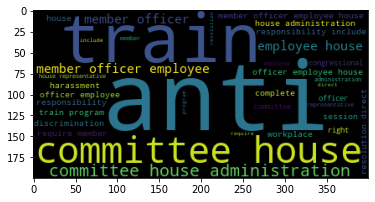

In [366]:
wordcloud = WordCloud().generate_from_frequencies(cloudy[5007])
plt.imshow(wordcloud)

In [376]:
X_test_final[::]

,cosponsor_ratio,CoSponsor_Count,abandon,abandon august,abandon august state,abandon august state approve,abandon august state approve reclamation,abandon copper,abandon copper mine,abandon copper mine land,...,zone term cascadia subduction,zone term cascadia subduction zone,zte,zte corporation,zte corporation entity,zte corporation entity reasonably,zte corporation entity reasonably believe,zte corporation high,zte corporation high impact,zte corporation high impact moderate
5007,0.000000,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
313,10.000000,11,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4991,0.000000,39,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3449,1.833333,17,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
511,0.000000,2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1021,2.000000,6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
598,0.000000,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5050,0.000000,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5735,0.000000,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


TypeError: savefig() takes 2 positional arguments but 4 were given

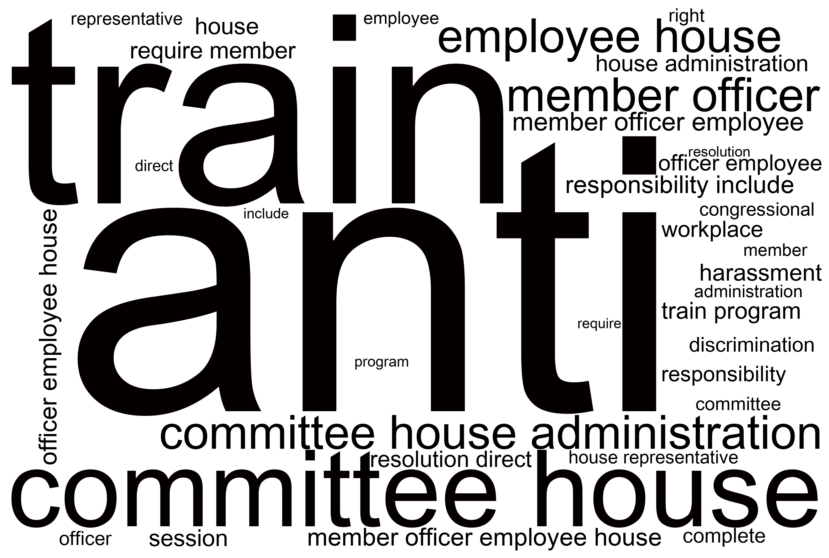

In [371]:


for r in cloudy.columns:
    name=r
    # change the value to black
    def black_color_func(word, font_size, position,orientation,random_state=None, **kwargs):
        return("hsl(0,100%, 1%)")
    # set the wordcloud background color to white
    # set max_words to 1000
    # set width and height to higher quality, 3000 x 2000
    wordcloud = WordCloud(font_path = '/Library/Fonts/Arial Unicode.ttf', background_color="white", width=3000, height=2000, max_words=500).generate_from_frequencies(cloudy[name])
    # set the word color to black
    wordcloud.recolor(color_func = black_color_func)
    # set the figsize
    plt.figure(figsize=[15,10])
    # plot the wordcloud
    plt.imshow(wordcloud, interpolation="bilinear")
    # remove plot axes
    plt.axis("off")
    # save the image
    plt.savefig('images/passingwords.png')

In [405]:


import matplotlib.pyplot as plt
from wordcloud import WordCloud


PassingCloudData=dataset.loc[dataset['bill_progress'] == 'Became Law']


from sklearn.feature_extraction.text import TfidfVectorizer
vectorizer = TfidfVectorizer(preprocessor=doc_preparer, ngram_range = (1,5), max_features=1000)


PassingCloudData_FT=vectorizer.fit_transform((PassingCloudData['summary']))

vectorized_cloud=pd.DataFrame.sparse.from_spmatrix(PassingCloudData_FT, columns=sorted(vectorizer.vocabulary_))



In [406]:

cloudy=vectorized_cloud.transpose()

cloudy


,0,1,2,3,4,5,6,7,8,9,...,25,26,27,28,29,30,31,32,33,34
accommodate,0.000000,0.000000,0.0,0.0,0.0,0.0,0.00000,0.000000,0.0,0.0,...,0.0,0.000000,0.0,0.0,0.0,0.15854,0.000000,0.000000,0.000000,0.0
act,0.000000,0.000000,0.0,0.0,0.0,0.0,0.00000,0.101026,0.0,0.0,...,0.0,0.019071,0.0,0.0,0.0,0.00000,0.000000,0.130629,0.000000,0.0
additionally,0.000000,0.051158,0.0,0.0,0.0,0.0,0.00000,0.000000,0.0,0.0,...,0.0,0.000000,0.0,0.0,0.0,0.00000,0.076510,0.041244,0.058636,0.0
additionally bill,0.000000,0.065319,0.0,0.0,0.0,0.0,0.00000,0.000000,0.0,0.0,...,0.0,0.000000,0.0,0.0,0.0,0.00000,0.000000,0.000000,0.000000,0.0
additionally cr,0.000000,0.000000,0.0,0.0,0.0,0.0,0.00000,0.000000,0.0,0.0,...,0.0,0.000000,0.0,0.0,0.0,0.00000,0.097688,0.052661,0.074867,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
without,0.000000,0.000000,0.0,0.0,0.0,0.0,0.00000,0.000000,0.0,0.0,...,0.0,0.011173,0.0,0.0,0.0,0.00000,0.000000,0.000000,0.000000,0.0
work,0.000000,0.000000,0.0,0.0,0.0,0.0,0.07236,0.000000,0.0,0.0,...,0.0,0.010251,0.0,0.0,0.0,0.00000,0.000000,0.000000,0.000000,0.0
year,0.057608,0.000000,0.0,0.0,0.0,0.0,0.00000,0.000000,0.0,0.0,...,0.0,0.009536,0.0,0.0,0.0,0.00000,0.000000,0.048986,0.000000,0.0
yuma list location court,0.000000,0.000000,0.0,0.0,0.0,0.0,0.00000,0.000000,0.0,0.0,...,0.0,0.000000,0.0,0.0,0.0,0.00000,0.000000,0.000000,0.000000,0.0


<ipython-input-407-744f7d0a5d68>:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=[15,10])


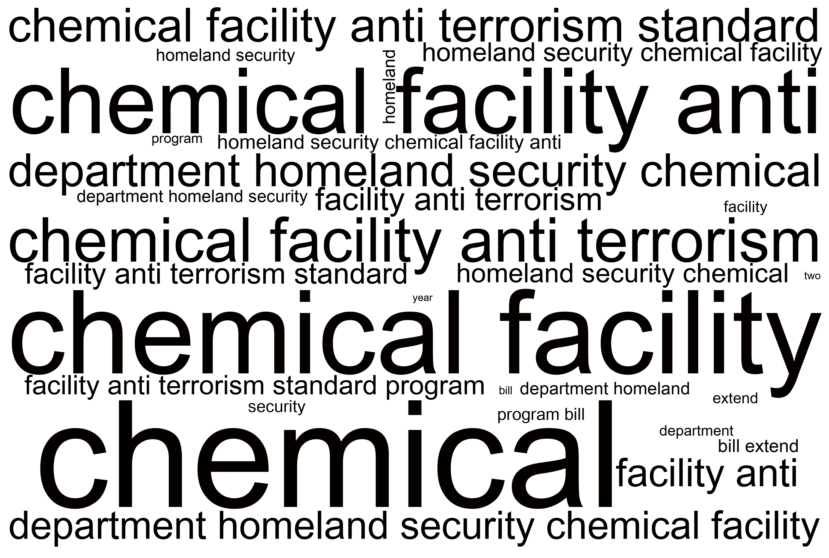

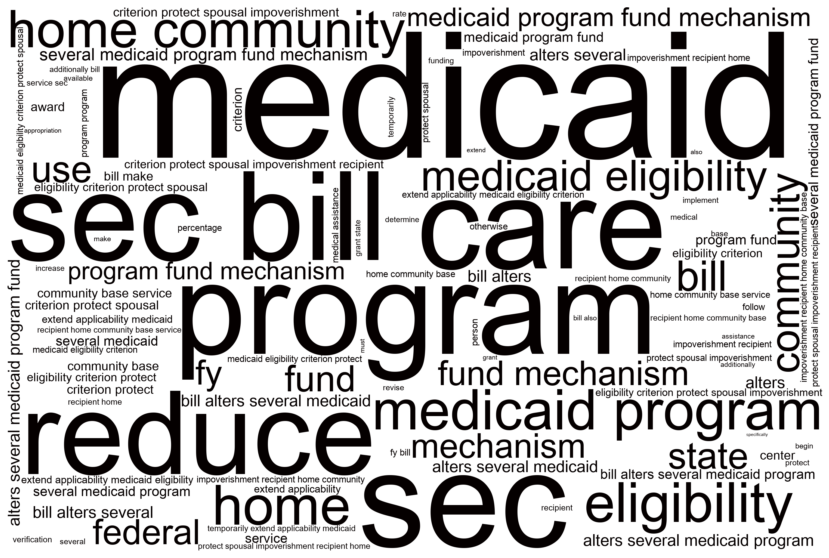

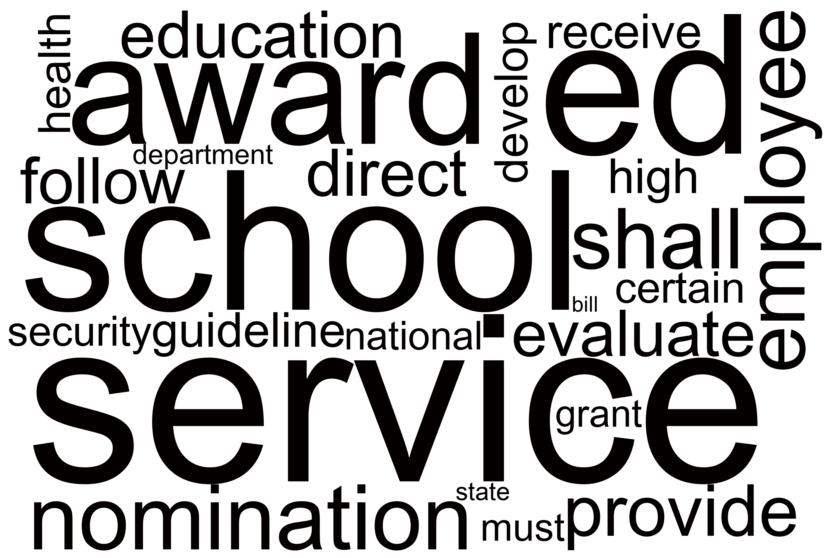

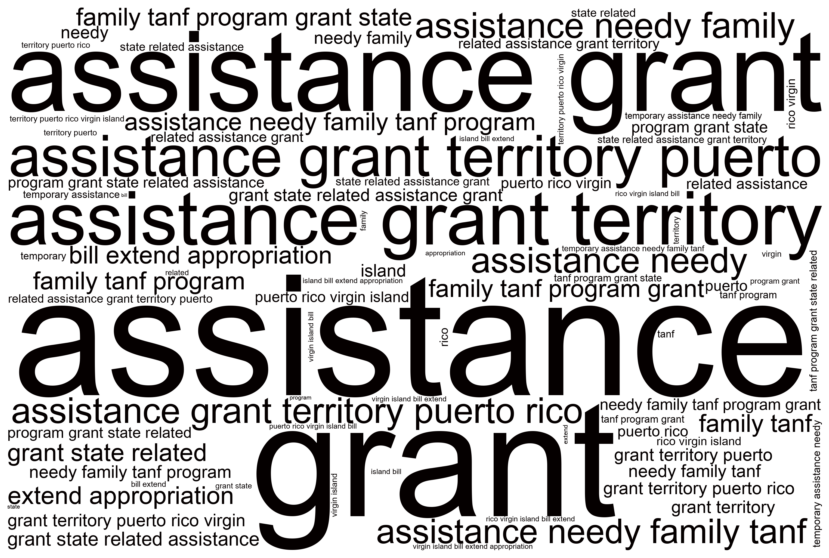

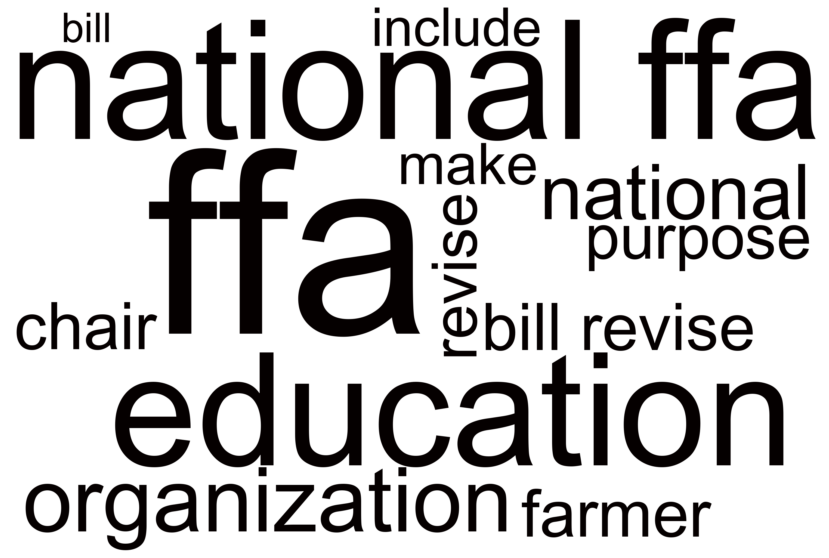

...

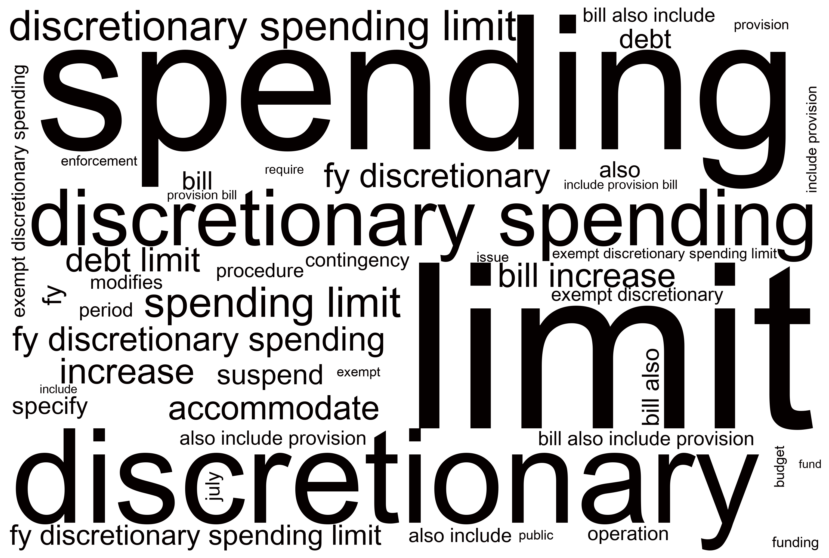

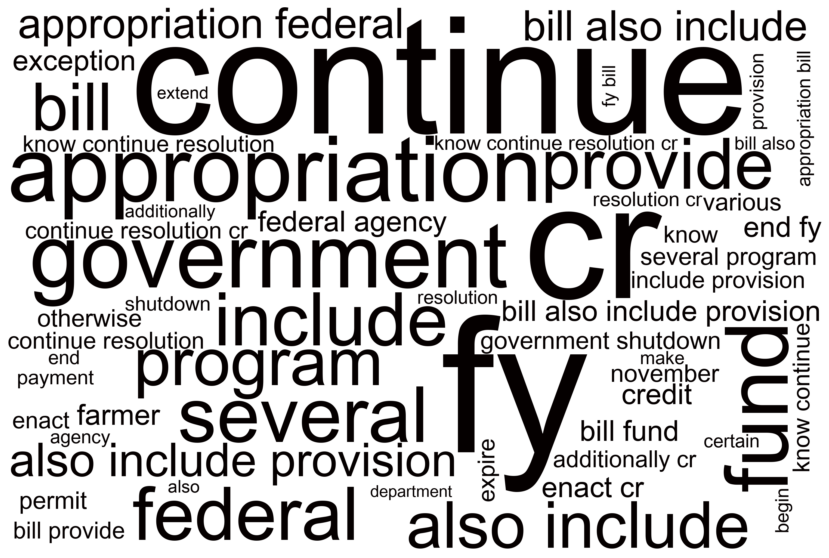

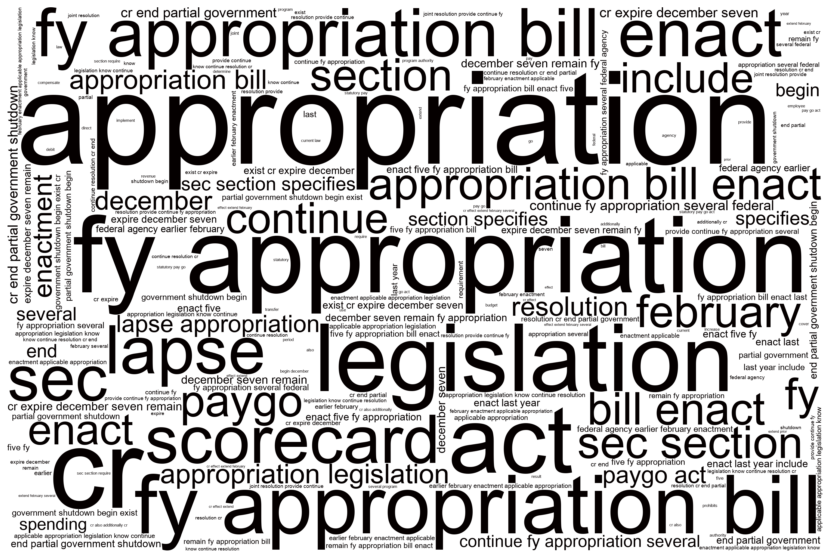

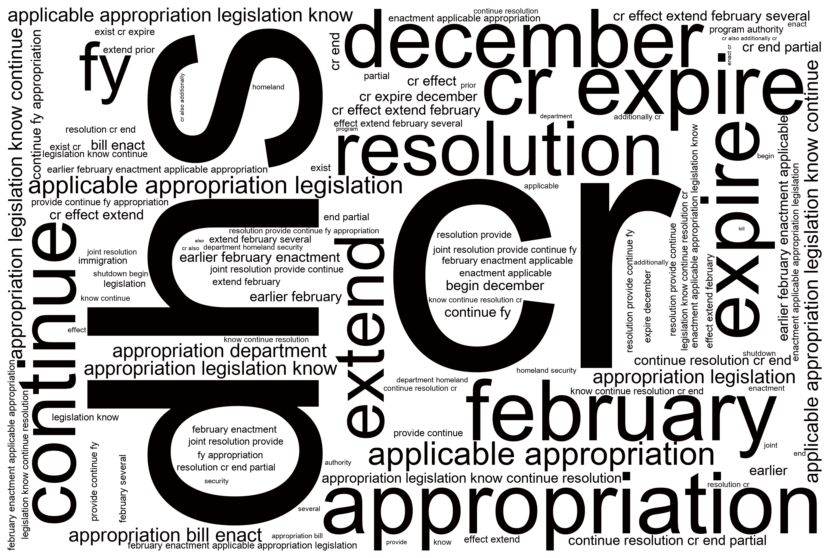

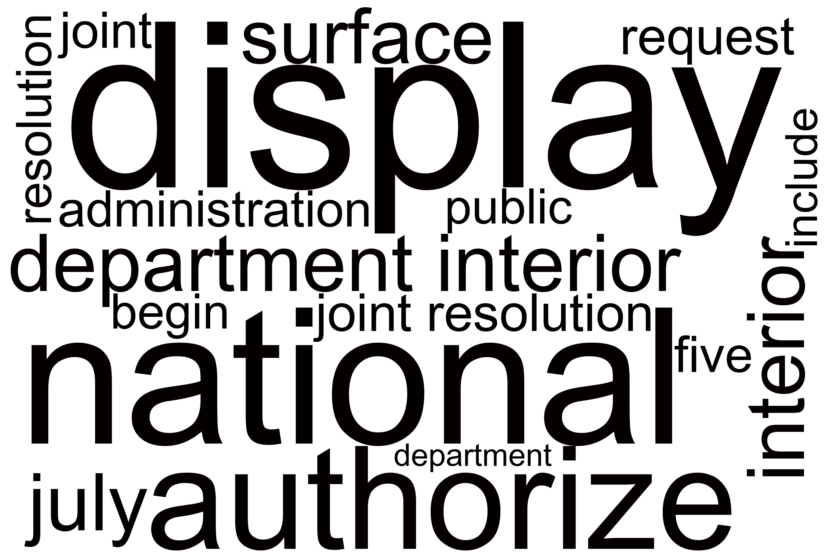

In [407]:

for r in cloudy.columns:
    name=r
    # change the value to black
    def black_color_func(word, font_size, position,orientation,random_state=None, **kwargs):
        return("hsl(0,100%, 1%)")
    # set the wordcloud background color to white
    # set max_words to 1000
    # set width and height to higher quality, 3000 x 2000
    wordcloud = WordCloud(font_path = '/Library/Fonts/Arial Unicode.ttf', background_color="white", width=3000, height=2000, max_words=500).generate_from_frequencies(cloudy[name])
    # set the word color to black
    wordcloud.recolor(color_func = black_color_func)
    # set the figsize
    plt.figure(figsize=[15,10])
    # plot the wordcloud
    plt.imshow(wordcloud, interpolation="bilinear")
    # remove plot axes
    plt.axis("off")
    # save the image
    path=f'images/{name}.png'
    plt.savefig(path)

In [445]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud


PassingCloudData=dataset.loc[dataset['bill_progress'] == 'Became Law']

passingbills=[]

for x in PassingCloudData['summary']:
    passingbills.append(x)
passingbills=pd.Series(passingbills)



wordcloud = WordCloud().generate_from_frequencies(passingbills)
plt.imshow(wordcloud)

ValueError: could not convert string to float: 'This joint resolution requests the Department of the Interior to authorize the unique display of National Aeronautics and Space Administration (NASA) and Smithsonian artifacts, digital content, film footage, and associated historic audio and imagery in the vicinity of the National Mall, including projections onto the surface of the Washington Monument for five nights of public display beginning on July 16, 2019.  This joint resolution requests the Department of the Interior to authorize the unique display of National Aeronautics and Space Administration (NASA) and Smithsonian artifacts, digital content, film footage, and associated historic audio and imagery in the vicinity of the National Mall, including projections onto the surface of the Washington Monument for five nights of public display beginning on July 16, 2019.  This joint resolution requests the Department of the Interior to authorize the unique display of National Aeronautics and Space Administration (NASA) and Smithsonian artifacts, digital content, film footage, and associated historic audio and imagery in the vicinity of the National Mall, including projections onto the surface of the Washington Monument for five nights of public display beginning on July 16, 2019.  This joint resolution requests the Department of the Interior to authorize the unique display of National Aeronautics and Space Administration (NASA) and Smithsonian artifacts, digital content, film footage, and associated historic audio and imagery in the vicinity of the National Mall, including projections onto the surface of the Washington Monument for five nights of public display beginning on July 16, 2019.  This joint resolution requests the Department of the Interior to authorize the unique display of National Aeronautics and Space Administration (NASA) and Smithsonian artifacts, digital content, film footage, and associated historic audio and imagery in the vicinity of the National Mall, including projections onto the surface of the Washington Monument for five nights of public display beginning on July 16, 2019. '

In [443]:


from sklearn.feature_extraction.text import TfidfVectorizer
vectorizer2 = TfidfVectorizer(preprocessor=prep, ngram_range = (1,5), max_features=1000)


PassingCloudData_FT2=vectorizer2.fit_transform(res)


PassingCloudData_FT2




vectorized_cloud2=pd.DataFrame.sparse.from_spmatrix(PassingCloudData_FT2, columns=sorted(vectorizer2.vocabulary_))

cloudy2=vectorized_cloud2.transpose()

cloudy2

ValueError: Iterable over raw text documents expected, string object received.